1. get (9) acquisition functions for the given dataset, feature, metric
2. results to a dataframe, then create a separate df for each acq function where rows*cols = cycles*seeds
3. plot each acquisition function (mean, std)

In [2]:
from collections import defaultdict
from unittest import result
import pandas as pd
import glob
import sys
import numpy as np
import matplotlib.pyplot as plt
import os

In [3]:
def get_results(folders, data, feature, metric):
    results = defaultdict(list)
    for folder in folders:
        for ack in glob.glob(folder + '/' + data + '/' + feature + '/*'):
            #print('ack',ack)
            _ack = ack.replace(data + '/' + feature + '/', '')
            if os.name == 'nt': # if on windows os
                _ack =_ack=_ack.split('\\')[-1] 
            results[_ack] = defaultdict(list)
            for seed in glob.glob(ack + '/*'):
                _seed = seed.replace(ack + '/', '')
                if os.name == 'nt': # if on windows os
                    _seed = _seed.split('\\')[-1] 
                #print(_ack, _seed)
                d = pd.read_pickle(seed + '/results.pickle')
                for cycle in range(len(d)):
                    results[_ack][_seed].append(d[cycle][metric])
    return results
    
def explode_cycles(df):
    return df.explode(df.columns.values.tolist()).reset_index(drop=True)

def create_df_per_acq_function(df):
    dfs = []
    for acq in df.index:
        acq_df = df[df.index==acq]
        acq_df = explode_cycles(acq_df)
        dfs.append(acq_df)
    return dfs

In [4]:
def plot_acq_together(df,acq_name,color,data,feat,metric):
    #acq_names=['acq_softuncertain','acq_softuncertain_05','acq_softuncertain_07','acq_ernd'] #only plot these functions
    D=df.to_numpy().astype(float)
    sems = np.std(D, axis=1, ddof=1) / np.sqrt(np.size(D))
    means =np.mean(D, axis = 1)

    plt.xlabel('cycles')
    plt.ylabel(f'metric ({metric})')
    plt.title(f'Mean and stderr over cycles for all acquisition functions\nfor {data} and {feat}')
    if True:
    #if acq_name in acq_names:
        plt.plot([0,1,2,3,4,5,6,7],
                        means,
                        lw=1.5,
                        ls="-", label=acq_name, color=color,
                    )

        plt.fill_between(x=[0,1,2,3,4,5,6,7],
                        y1=means - 1.96 * sems,
                        y2=means + 1.96 * sems,
                        alpha=0.3, color=color
                    )
    #plt.legend(loc='best')
    lgd = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    #plt.tight_layout()
    plt.savefig(f'plots/all_aqc_({data},{feat},{metric}).jpg',dpi=100, bbox_extra_artists=(lgd,), bbox_inches='tight')

In [5]:
def run(folders, dataset,feat,metric):
    results = get_results(folders, dataset, feat, metric)
    df = pd.DataFrame.from_dict(results, orient='index')
    if len(colors)>=len(df):
        dfs = create_df_per_acq_function(df)
        for i in range(len(dfs)):
            plot_acq_together(dfs[i], df.index[i], colors[i], dataset, feat, metric)
            #plot_acq_against(dfs[i], df.index[i], colors[i], dataset, feat, metric)
            if i == len(dfs) - 1:
                plt.show()
                plt.clf()
    else:
        print(f'ERROR: add more colors to match the number of acquisition functions; len(colors): {len(colors)} < len(acq functions): {len(df)}')
    

In [26]:
def plot_acq_against(df,acq_name,color,data,feat,metric, chosen_acq_func):
    #acq_names=['acq_softuncertain','acq_softuncertain_05','acq_softuncertain_07','acq_ernd'] #only plot these functions
    #chosen_acq = 'acq_softuncertain_07'
    D=df.to_numpy().astype(float)
    sems = np.std(D, axis=1, ddof=1) / np.sqrt(np.size(D))
    means =np.mean(D, axis = 1)

    plt.xlabel('cycles')
    plt.ylabel(f'metric ({metric})')
    plt.title(f'Mean and stderr over cycles for all acquisition functions\nfor {data} and {feat}')
    
    if acq_name == chosen_acq_func:
        #color='red'
        print(color)
        plt.plot([0,1,2,3,4,5,6,7],
                        means,
                        lw=1.5,
                        ls="-", label=acq_name, color=color,
                    )

        plt.fill_between(x=[0,1,2,3,4,5,6,7],
                        y1=means - 1.96 * sems,
                        y2=means + 1.96 * sems,
                        alpha=0.5, color=color
                    )
    else:
        #color='blue'
        plt.plot([0,1,2,3,4,5,6,7],
                        means,
                        lw=1.5,
                        ls="-", label=acq_name, color=color, alpha=0.2,
                    )

        plt.fill_between(x=[0,1,2,3,4,5,6,7],
                        y1=means - 1.96 * sems,
                        y2=means + 1.96 * sems,
                        alpha=0.1, color=color,
                    )
        
    #plt.legend(loc='best')
    lgd = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig(f'plots/all_aqc_({data},{feat},{metric})_against_{chosen_acq_func}.jpg',dpi=100, bbox_extra_artists=(lgd,), bbox_inches='tight')
    #plt.savefig(f'plots/{chosen_acq_func}_against_all_aqc_({data},{feat},{metric}).jpg',dpi=100, bbox_extra_artists=(lgd,), bbox_inches='tight')

In [7]:
def run_against(folders, dataset,feat,metric, chosen_acq_func):
    results = get_results(folders, dataset, feat, metric)
    df = pd.DataFrame.from_dict(results, orient='index')
    if len(colors)>=len(df):
        dfs = create_df_per_acq_function(df)
        for i in range(len(dfs)):
            #plot_acq_together(dfs[i], df.index[i], colors[i], dataset, feat, metric)
            plot_acq_against(dfs[i], df.index[i], colors[i], dataset, feat, metric, chosen_acq_func)
            if i == len(dfs) - 1:
                plt.show()
                plt.clf()
    else:
        print(f'ERROR: add more colors to match the number of acquisition functions; len(colors): {len(colors)} < len(acq functions): {len(df)}')
    

In [5]:
#data = sys.argv[1]
#features = sys.argv[2]
#metric = sys.argv[3]

data = 'data_sanchez_2021_tau'
feature = 'feat_achilles'
metric = 'MeanAbsoluteError'
folders = ['output','output_umap_kde_run']

results = get_results(folders, data, feature, metric)
results

ack output/data_sanchez_2021_tau/feat_achilles\acq_adversarialBIM
ack output/data_sanchez_2021_tau/feat_achilles\acq_badge
ack output/data_sanchez_2021_tau/feat_achilles\acq_coreset
ack output/data_sanchez_2021_tau/feat_achilles\acq_custom
ack output/data_sanchez_2021_tau/feat_achilles\acq_kmeans_data
ack output/data_sanchez_2021_tau/feat_achilles\acq_kmeans_embedding
ack output/data_sanchez_2021_tau/feat_achilles\acq_marginsample
ack output/data_sanchez_2021_tau/feat_achilles\acq_random
ack output/data_sanchez_2021_tau/feat_achilles\acq_softuncertain
ack output/data_sanchez_2021_tau/feat_achilles\acq_topuncertain
ack output_umap_kde_run/data_sanchez_2021_tau/feat_achilles\acq_kde
ack output_umap_kde_run/data_sanchez_2021_tau/feat_achilles\acq_umap


defaultdict(list,
            {'acq_adversarialBIM': defaultdict(list,
                         {'seed_1972492700': [0.64885116,
                           0.52337897,
                           0.6139177,
                           0.5491529,
                           0.4651787,
                           0.5243575,
                           0.51989037,
                           0.51385826],
                          'seed_2106424110': [0.4733613,
                           0.8045728,
                           0.5652856,
                           0.5158462,
                           0.44965714,
                           0.48293483,
                           0.51793265,
                           0.5200209],
                          'seed_305273120': [0.5988778,
                           0.42740884,
                           0.5290483,
                           0.48341697,
                           0.51730865,
                           0.47938076,
                        

In [1]:

#data = sys.argv[1]
#features = sys.argv[2]
#metric = sys.argv[3]

data = 'data_schmidt_2021_ifng'
feature = 'feat_achilles'
metric = 'MeanAbsoluteError'
folders = ['output','output_rnd','output_umap']

results = get_results(folders, data, feature, metric)
results

NameError: name 'get_results' is not defined

In [7]:
df = pd.DataFrame.from_dict(results,orient='index')
df

,seed_1972492700,seed_2106424110,seed_305273120,seed_876856523,seed_993364151
acq_adversarialBIM,"[0.19257663, 0.24243417, 0.17420197, 0.2095262...","[0.15494326, 0.16798104, 0.15424515, 0.1533395...","[0.46507424, 0.21057436, 0.18364115, 0.1486859...","[0.18290758, 0.1502355, 0.18073067, 0.16828069...","[0.2747923, 0.13496853, 0.16815951, 0.12845409..."
acq_badge,"[0.19257663, 0.2530193, 0.20807892, 0.18019803...","[0.15494326, 0.17162047, 0.16459255, 0.1712554...","[0.46507424, 0.18857087, 0.18543299, 0.1813546...","[0.18290758, 0.1834983, 0.17764181, 0.19008037...","[0.2747923, 0.1954057, 0.17099233, 0.17917193,..."
acq_coreset,"[0.19257663, 0.2629496, 0.19406122, 0.21420363...","[0.15494326, 0.1932745, 0.19039159, 0.2207615,...","[0.46507424, 0.24444321, 0.22045785, 0.2112903...","[0.18290758, 0.20162705, 0.18254904, 0.1588724...","[0.2747923, 0.26838535, 0.22128817, 0.1547165,..."
acq_kmeans_data,"[0.19257663, 0.18903601, 0.18500581, 0.161095,...","[0.15494326, 0.19765614, 0.18607064, 0.1460157...","[0.46507424, 0.24968255, 0.19888632, 0.1641131...","[0.18290758, 0.1579924, 0.19381683, 0.1463975,...","[0.2747923, 0.1818084, 0.17202896, 0.16291271,..."
acq_kmeans_embedding,"[0.19257663, 0.1799468, 0.17984061, 0.19352427...","[0.15494326, 0.16163158, 0.17079951, 0.1477064...","[0.46507424, 0.17550014, 0.16003597, 0.1545904...","[0.18290758, 0.15999858, 0.17409272, 0.1449650...","[0.2747923, 0.17219514, 0.21372186, 0.1766333,..."
acq_marginsample,"[0.19257663, 0.1481327, 0.15833108, 0.17187616...","[0.15494326, 0.16885632, 0.20269132, 0.1577161...","[0.46507424, 0.16724624, 0.21716477, 0.1660607...","[0.18290758, 0.15238108, 0.21794748, 0.2011365...","[0.2747923, 0.17889704, 0.1545792, 0.16474667,..."
acq_random,"[0.19257663, 0.19214179, 0.17067392, 0.1368881...","[0.15494326, 0.12072924, 0.13069291, 0.1658051...","[0.46507424, 0.14437927, 0.15658595, 0.2042790...","[0.18290758, 0.16050886, 0.13858959, 0.1621307...","[0.2747923, 0.15837535, 0.18421404, 0.1935793,..."
acq_softuncertain,"[0.19257663, 0.23813424, 0.24000424, 0.1989233...","[0.15494326, 0.1662979, 0.14518592, 0.19189095...","[0.46507424, 0.1929803, 0.14574207, 0.16511391...","[0.18290758, 0.14895841, 0.17333451, 0.1673465...","[0.2747923, 0.16622466, 0.14136456, 0.15085387..."
acq_topuncertain,"[0.19257663, 0.14825104, 0.2299239, 0.22052862...","[0.15494326, 0.2952577, 0.19553493, 0.17781553...","[0.46507424, 0.19237396, 0.20684017, 0.2160379...","[0.18290758, 0.16483195, 0.17317401, 0.1684651...","[0.2747923, 0.16564082, 0.14584617, 0.15606287..."
acq_rnd,"[0.30422488, 0.183226, 0.26362443, 0.23108414,...","[0.2005172, 0.32625118, 0.17928167, 0.12677282...","[0.2064504, 0.3348392, 0.28658876, 0.22047493,...","[0.17638904, 0.29281127, 0.21880887, 0.1784753...","[0.18714812, 0.17749204, 0.2177701, 0.24034916..."


In [8]:
dfs = create_df_per_acq_function(df)
dfs
dfs[1]

,seed_1972492700,seed_2106424110,seed_305273120,seed_876856523,seed_993364151
0,0.192577,0.154943,0.465074,0.182908,0.274792
1,0.253019,0.17162,0.188571,0.183498,0.195406
2,0.208079,0.164593,0.185433,0.177642,0.170992
3,0.180198,0.171255,0.181355,0.19008,0.179172
4,0.175328,0.210472,0.144032,0.175718,0.174641
5,0.160868,0.19045,0.143323,0.180669,0.166703
6,0.179386,0.179696,0.155401,0.176358,0.17642
7,0.163547,0.154242,0.152803,0.177174,0.155963


In [11]:
dfs = create_df_per_acq_function(df)
dfs
len(dfs)
dfs[-1]
#dfs[10]

,seed_1972492700,seed_2106424110,seed_305273120,seed_876856523,seed_993364151
0,0.304225,0.200517,0.20645,0.176389,0.187148
1,0.183226,0.326251,0.334839,0.292811,0.177492
2,0.263624,0.179282,0.286589,0.218809,0.21777
3,0.231084,0.126773,0.220475,0.178475,0.240349
4,0.204542,0.137338,0.181626,0.177958,0.181183
5,0.216177,0.208464,0.20048,0.221707,0.20847
6,0.187893,0.142727,0.225384,0.227318,0.183018
7,0.18541,0.207,0.171673,0.23242,0.1759


In [19]:
#function for plotting each acqusition function separately
'''
def plot_acq(df,acq_name,color):
    fig1, ax1 = plt.subplots()
    D=df.to_numpy().astype(float)
    sems = np.std(D, axis=1, ddof=1) / np.sqrt(np.size(D))
    means =np.mean(D, axis = 1)

    
    plt.xlabel('cycles')
    plt.ylabel(f'metric ({metric})')
    plt.title(f'Mean and stderr over cycles for {acq_name} acquisition function\nfor {data} and {features}')
    
    ax1.plot([0,1,2,3,4,5,6,7],
                        means,
                        lw=6,
                        ls=":", label=acq_name, color=color
                    )

    ax1.fill_between(x=[0,1,2,3,4,5,6,7],
                        y1=means - 1.96 * sems,
                        y2=means + 1.96 * sems,
                        alpha=0.3, color=color
                    )
    ax1.legend(loc='best')
    fig1.savefig(f'plot_{acq_name}.jpg')
'''

'\ndef plot_acq(df,acq_name,color):\n    fig1, ax1 = plt.subplots()\n    D=df.to_numpy().astype(float)\n    sems = np.std(D, axis=1, ddof=1) / np.sqrt(np.size(D))\n    means =np.mean(D, axis = 1)\n\n    \n    plt.xlabel(\'cycles\')\n    plt.ylabel(f\'metric ({metric})\')\n    plt.title(f\'Mean and stderr over cycles for {acq_name} acquisition function\nfor {data} and {features}\')\n    \n    ax1.plot([0,1,2,3,4,5,6,7],\n                        means,\n                        lw=6,\n                        ls=":", label=acq_name, color=color\n                    )\n\n    ax1.fill_between(x=[0,1,2,3,4,5,6,7],\n                        y1=means - 1.96 * sems,\n                        y2=means + 1.96 * sems,\n                        alpha=0.3, color=color\n                    )\n    ax1.legend(loc=\'best\')\n    fig1.savefig(f\'plot_{acq_name}.jpg\')\n'

In [20]:
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']
#for i in range(len(dfs)):
#    plot_acq(dfs[i],df.index[i],colors[i])

IndexError: list index out of range

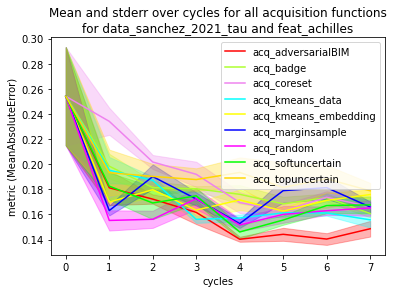

In [16]:
colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']
for i in range(len(dfs)):
    plot_acq_together(dfs[i],df.index[i],colors[i],data, feature, metric)

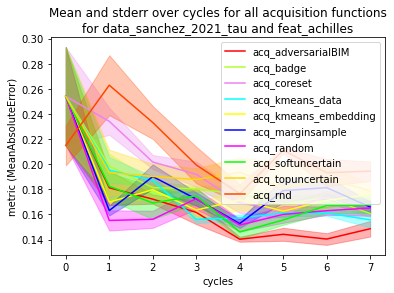

In [21]:
colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue']
for i in range(len(dfs)):
    plot_acq_together(dfs[i],df.index[i],colors[i],data, feature, metric)

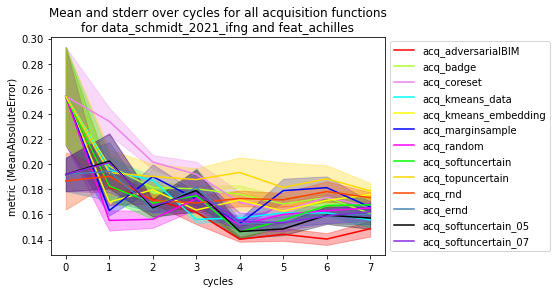

<Figure size 432x288 with 0 Axes>

In [22]:
data = 'data_schmidt_2021_ifng'
feature = 'feat_achilles'
metric = 'MeanAbsoluteError'
folders = ['output','output_rnd','output_umap', 'output_ernd']
colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue']

colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','black','blueviolet']

run(folders,data,feature,metric)

In [8]:
datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
feats = ['feat_achilles','feat_ccle','feat_string']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']
colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','deeppink','teal']

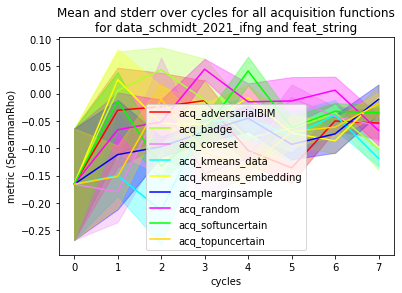

<Figure size 432x288 with 0 Axes>

In [26]:
run('data_schmidt_2021_ifng','feat_string','SpearmanRho')

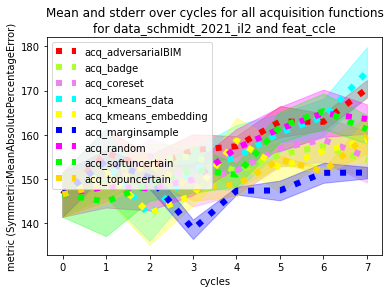

<Figure size 432x288 with 0 Axes>

In [19]:
run('data_schmidt_2021_il2','feat_ccle','SymmetricMeanAbsolutePercentageError')

plot 1 out of 60


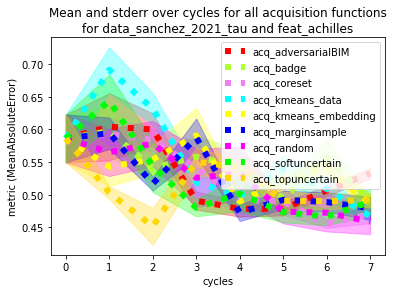

plot 2 out of 60


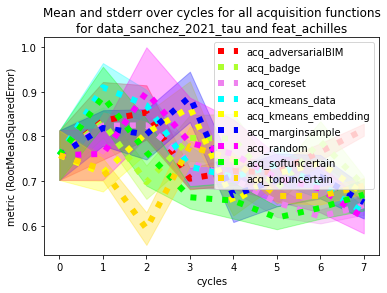

plot 3 out of 60


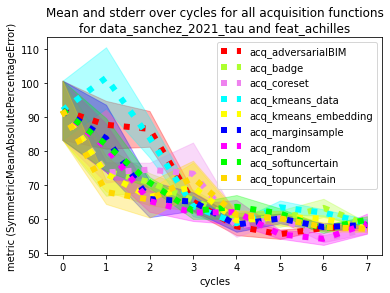

plot 4 out of 60


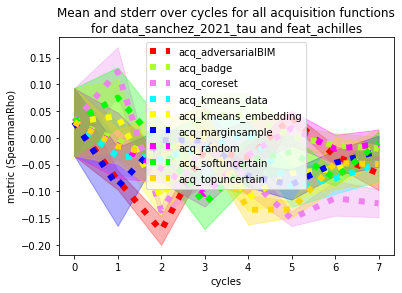

plot 5 out of 60


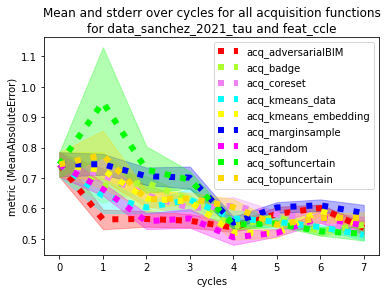

plot 6 out of 60


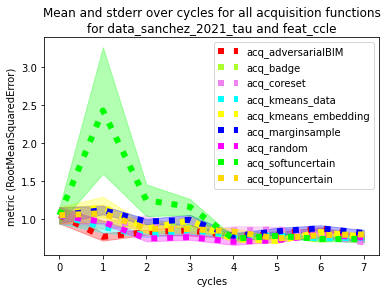

plot 7 out of 60


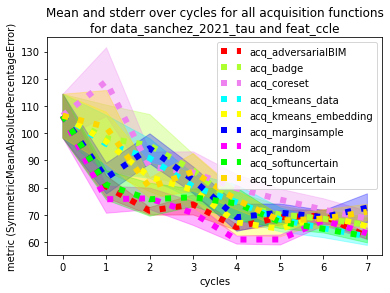

plot 8 out of 60


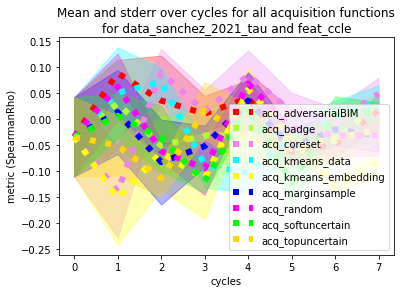

plot 9 out of 60


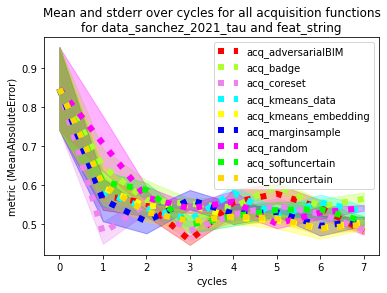

plot 10 out of 60


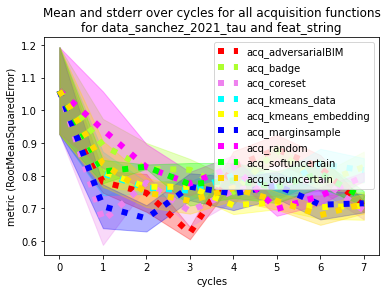

plot 11 out of 60


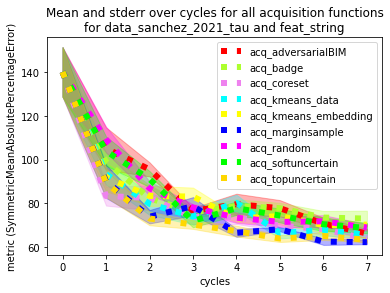

plot 12 out of 60


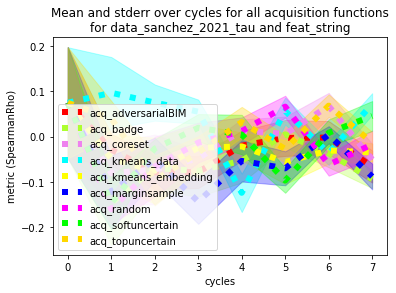

plot 13 out of 60


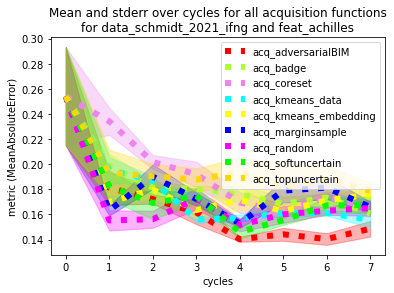

plot 14 out of 60


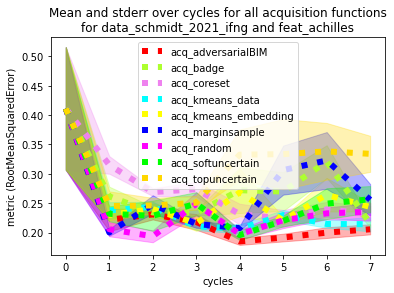

plot 15 out of 60


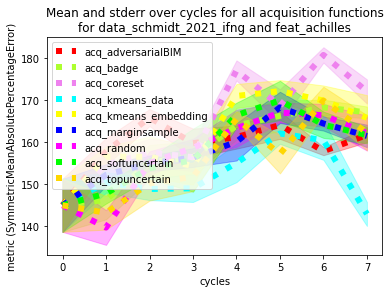

plot 16 out of 60


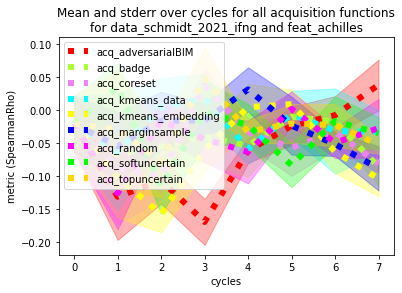

plot 17 out of 60


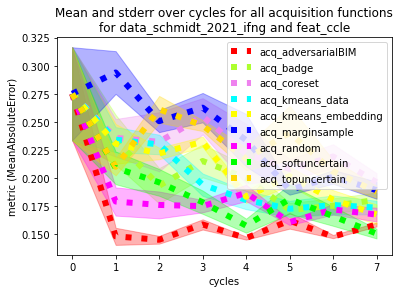

plot 18 out of 60


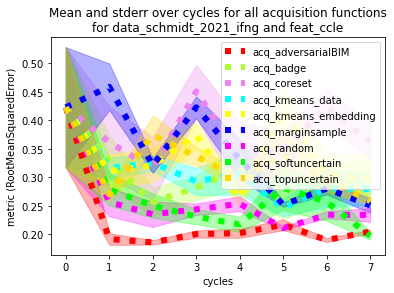

plot 19 out of 60


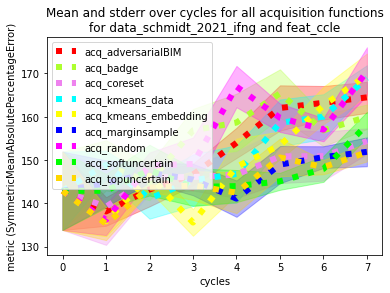

plot 20 out of 60


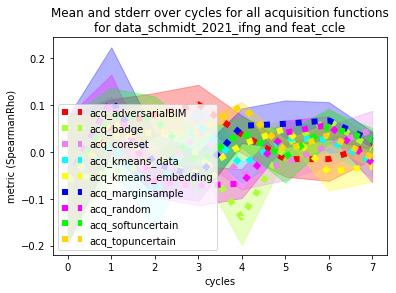

plot 21 out of 60


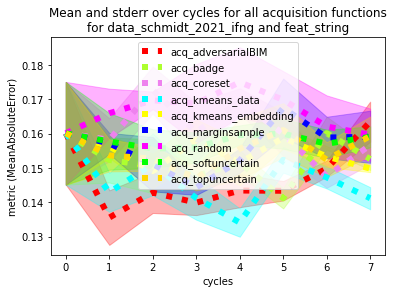

plot 22 out of 60


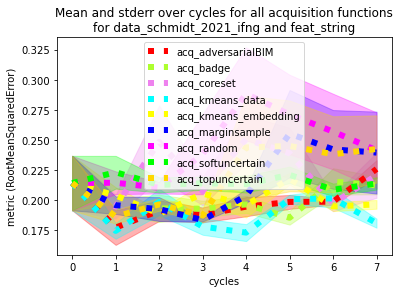

plot 23 out of 60


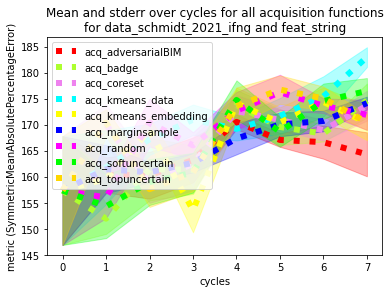

plot 24 out of 60


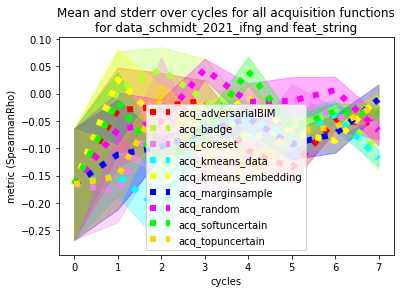

plot 25 out of 60


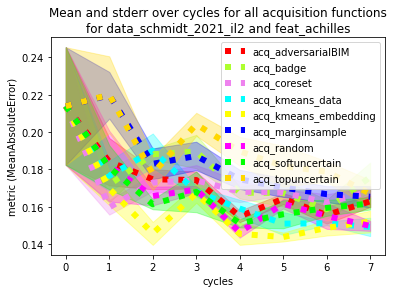

plot 26 out of 60


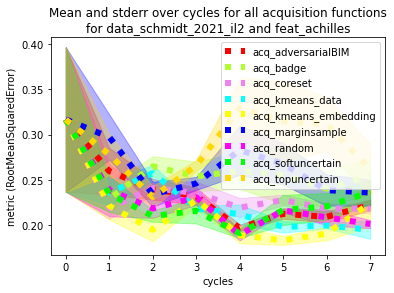

plot 27 out of 60


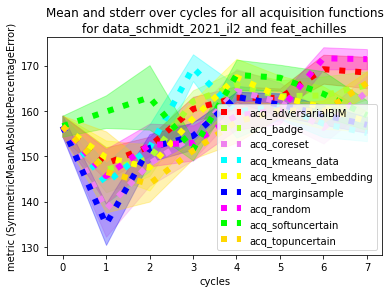

plot 28 out of 60


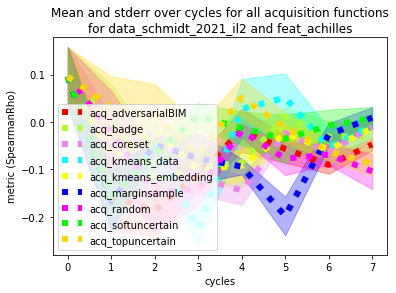

plot 29 out of 60


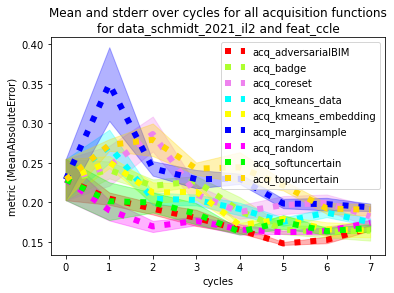

plot 30 out of 60


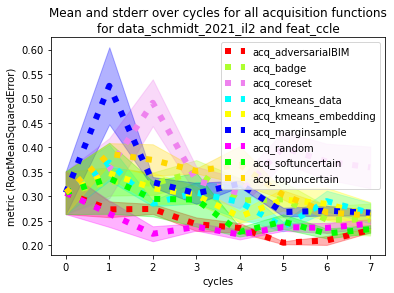

plot 31 out of 60


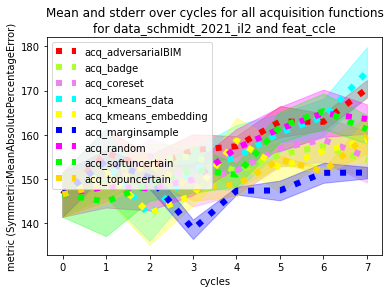

plot 32 out of 60


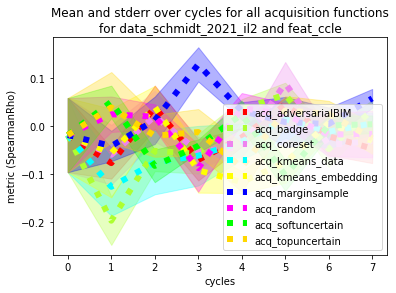

plot 33 out of 60


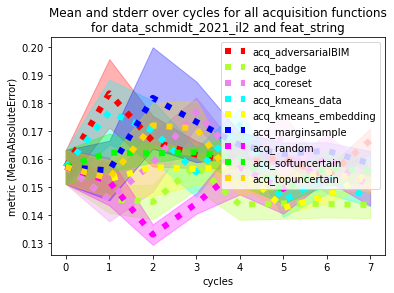

plot 34 out of 60


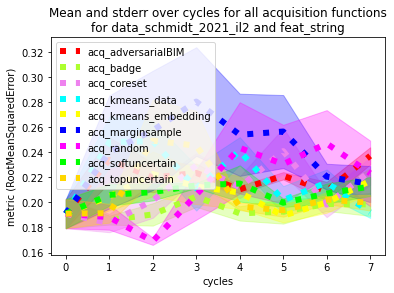

plot 35 out of 60


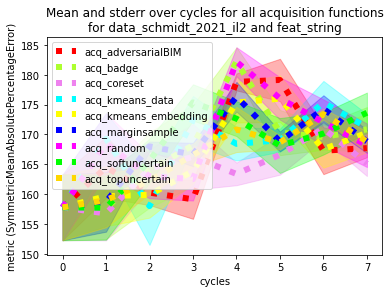

plot 36 out of 60


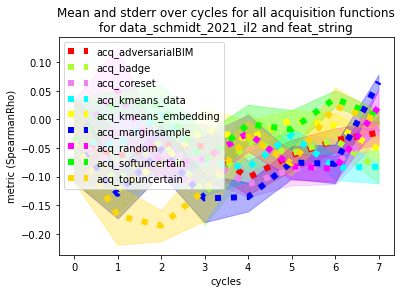

plot 37 out of 60


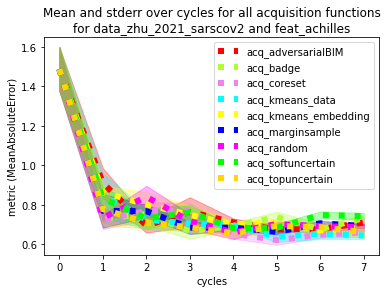

plot 38 out of 60


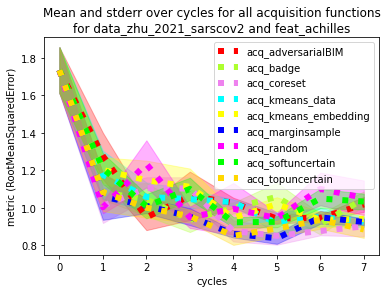

plot 39 out of 60


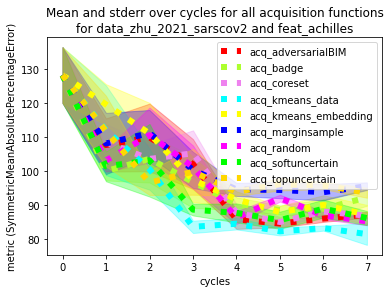

plot 40 out of 60


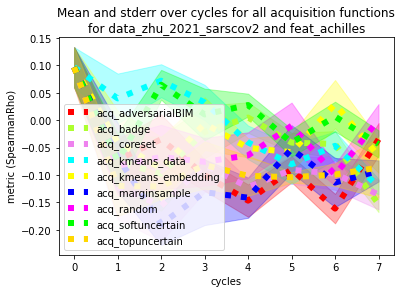

plot 41 out of 60


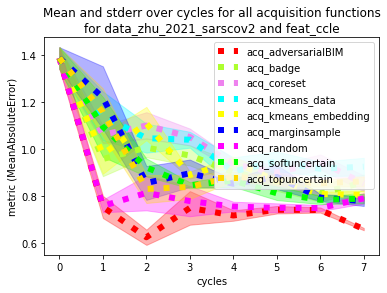

plot 42 out of 60


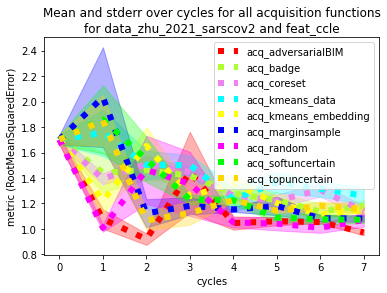

plot 43 out of 60


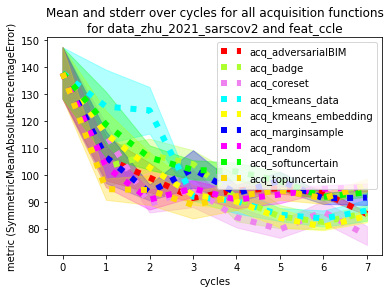

plot 44 out of 60


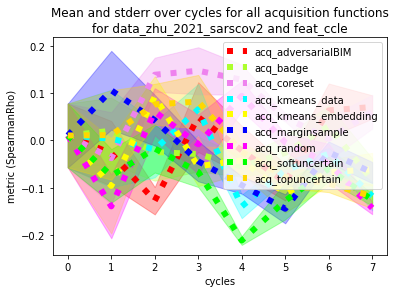

plot 45 out of 60


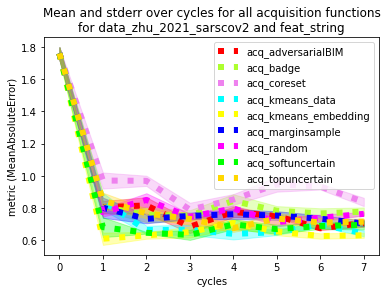

plot 46 out of 60


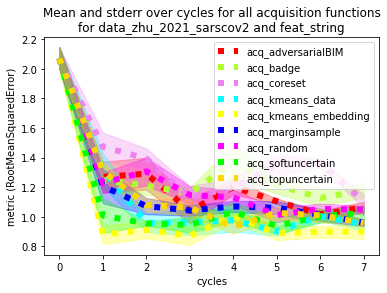

plot 47 out of 60


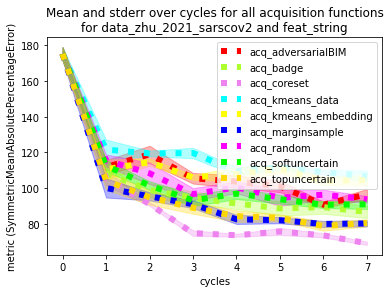

plot 48 out of 60


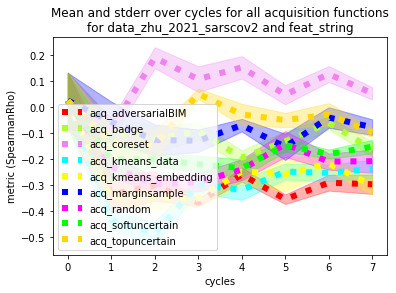

plot 49 out of 60


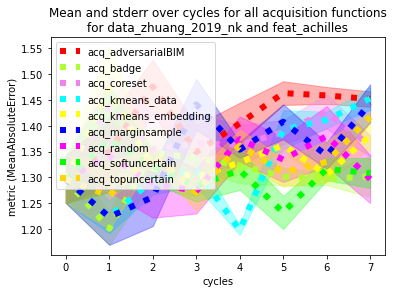

plot 50 out of 60


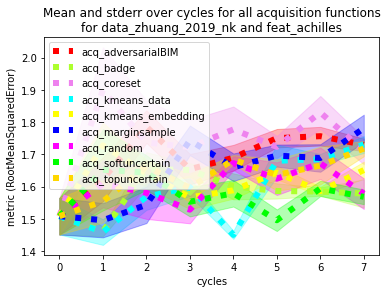

plot 51 out of 60


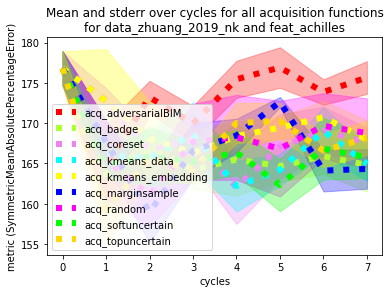

plot 52 out of 60


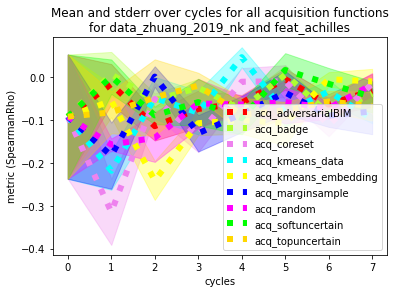

plot 53 out of 60


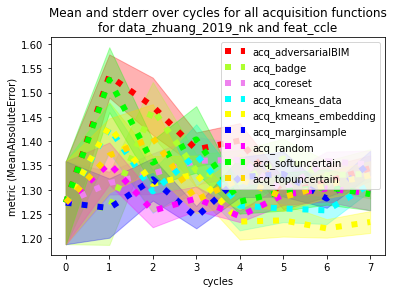

plot 54 out of 60


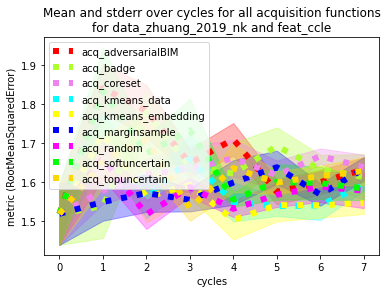

plot 55 out of 60


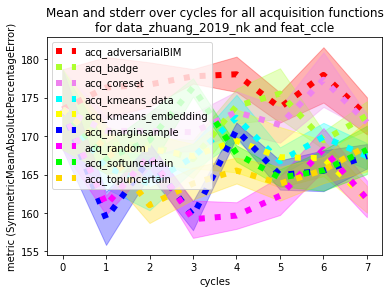

plot 56 out of 60


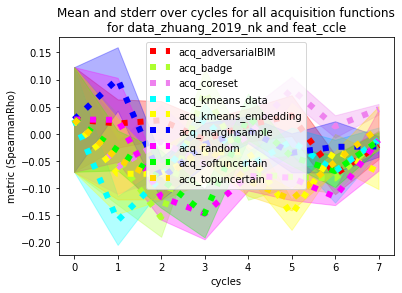

plot 57 out of 60


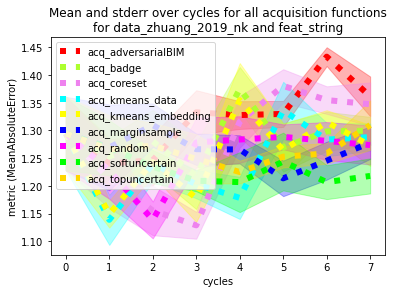

plot 58 out of 60


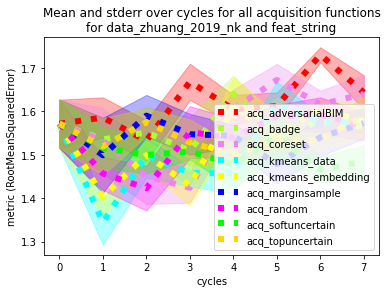

plot 59 out of 60


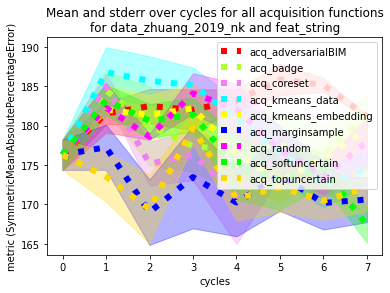

plot 60 out of 60


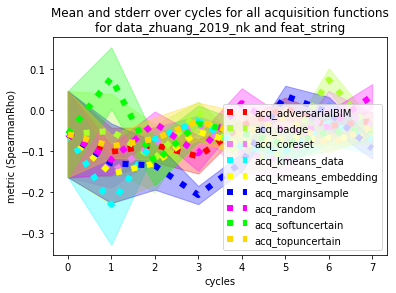

<Figure size 432x288 with 0 Axes>

In [26]:
i=0
for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run(dataset,feature,metric)
                

plot 1 out of 60


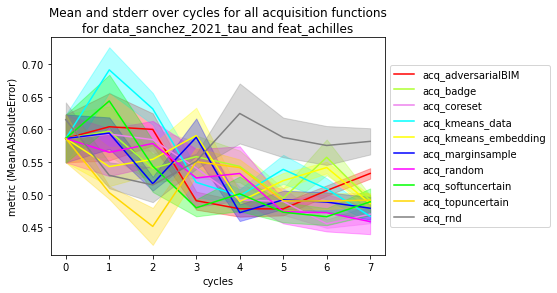

plot 2 out of 60


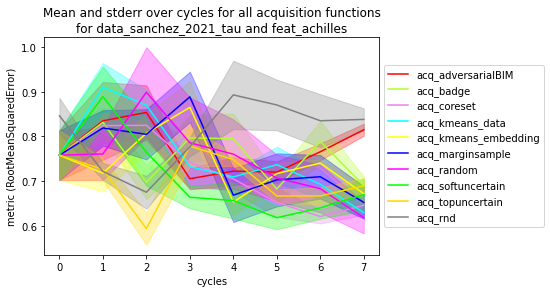

plot 3 out of 60


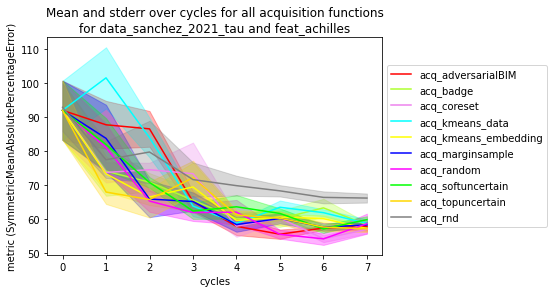

plot 4 out of 60


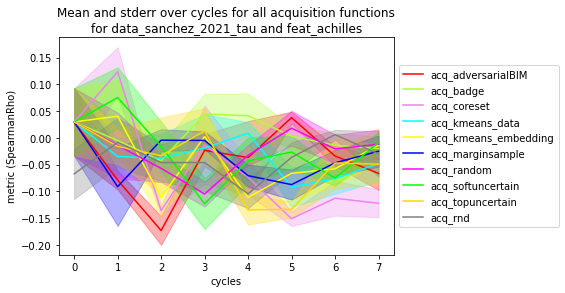

plot 5 out of 60


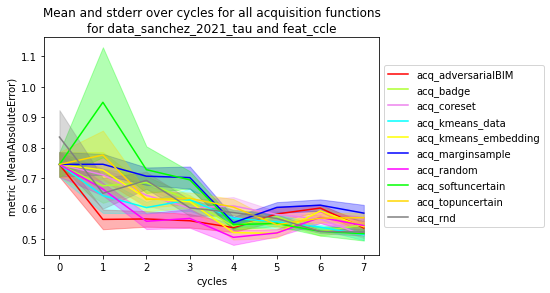

plot 6 out of 60


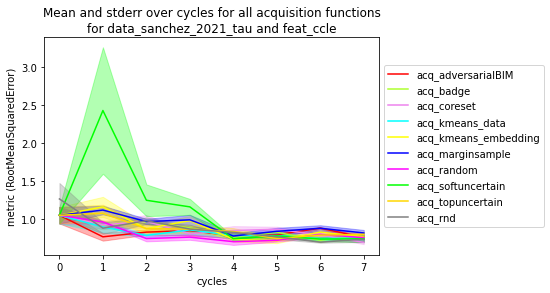

plot 7 out of 60


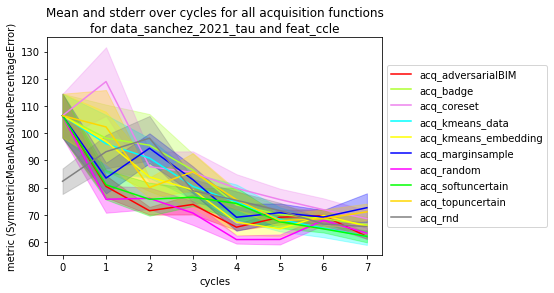

plot 8 out of 60


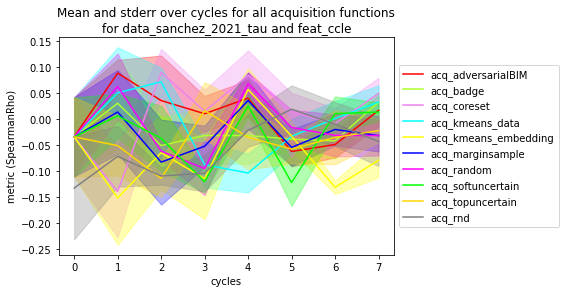

plot 9 out of 60


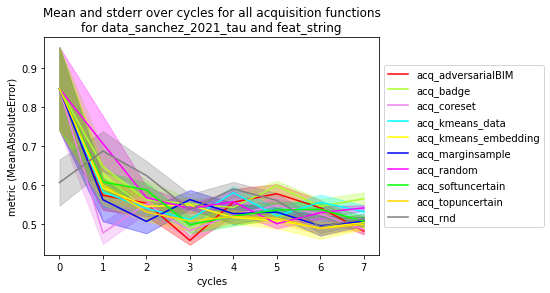

plot 10 out of 60


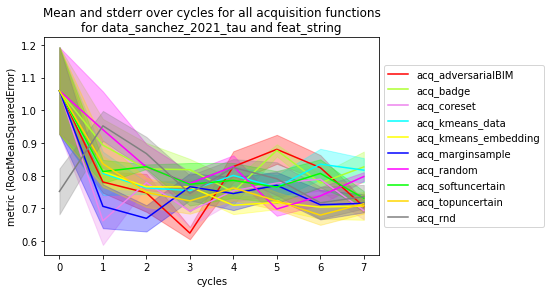

plot 11 out of 60


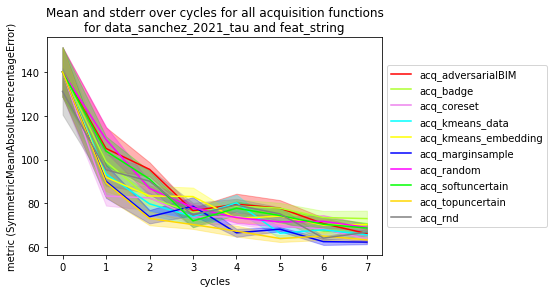

plot 12 out of 60


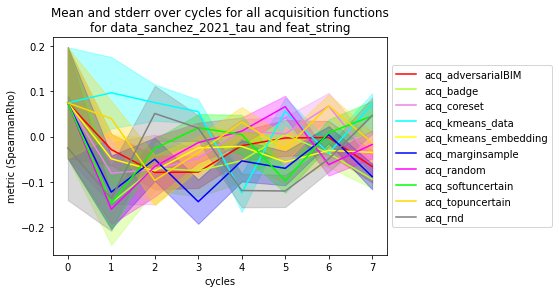

plot 13 out of 60


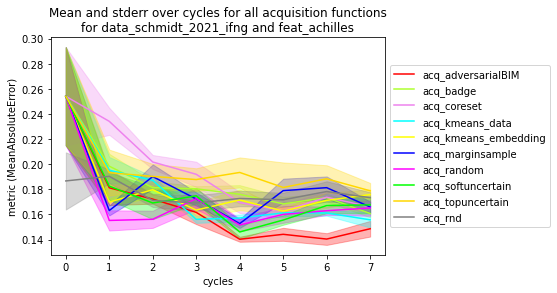

plot 14 out of 60


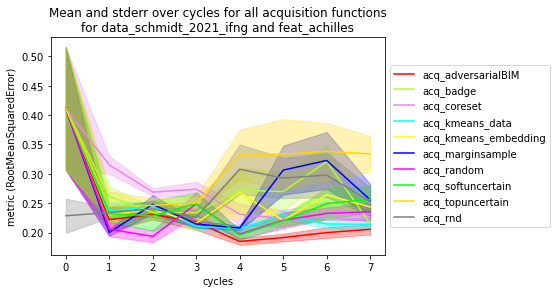

plot 15 out of 60


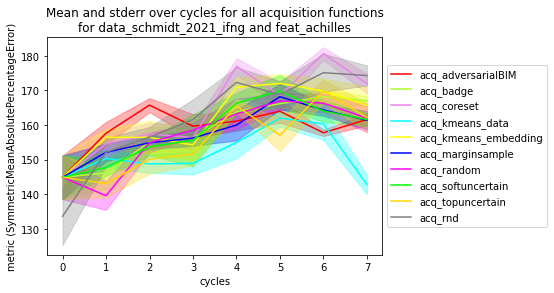

plot 16 out of 60


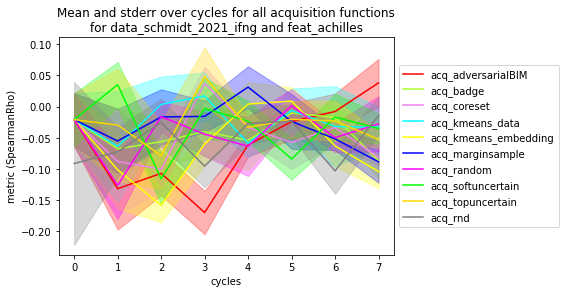

plot 17 out of 60


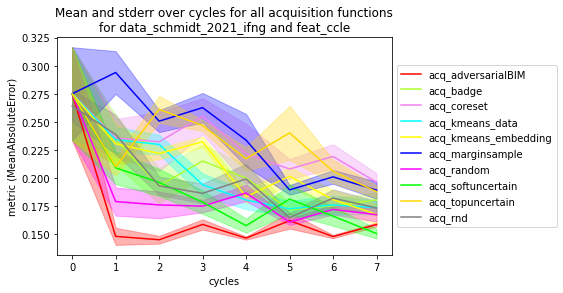

plot 18 out of 60


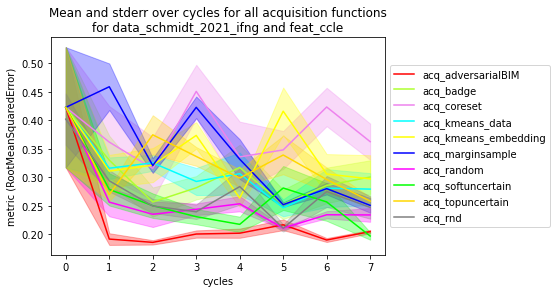

plot 19 out of 60


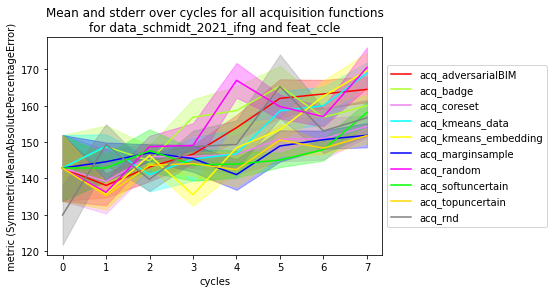

plot 20 out of 60


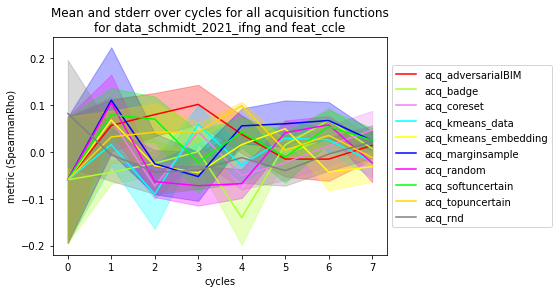

plot 21 out of 60


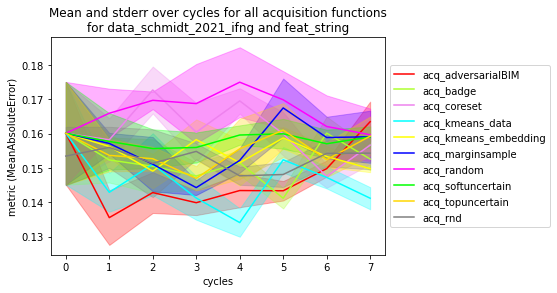

plot 22 out of 60


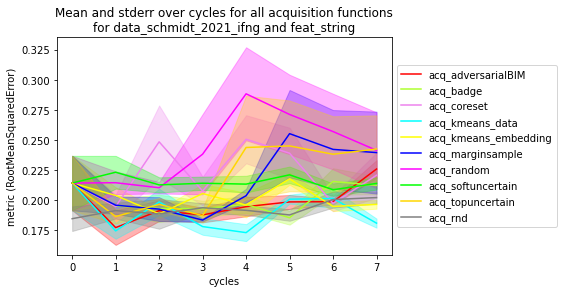

plot 23 out of 60


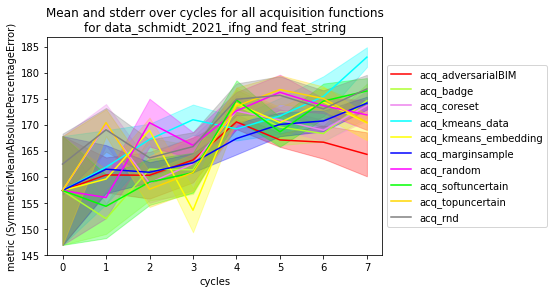

plot 24 out of 60


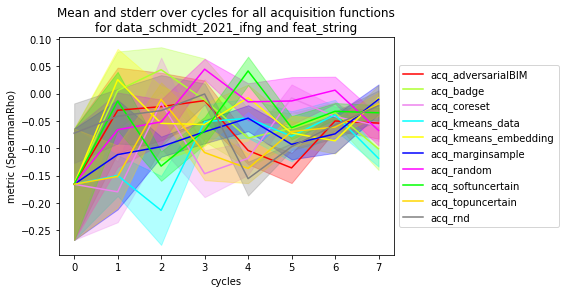

plot 25 out of 60


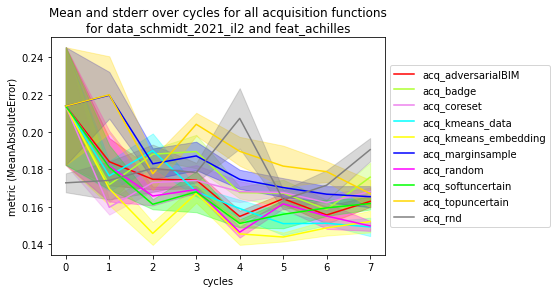

plot 26 out of 60


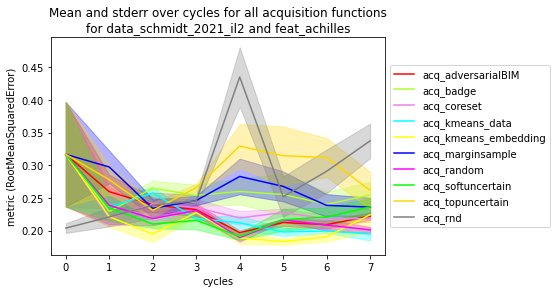

plot 27 out of 60


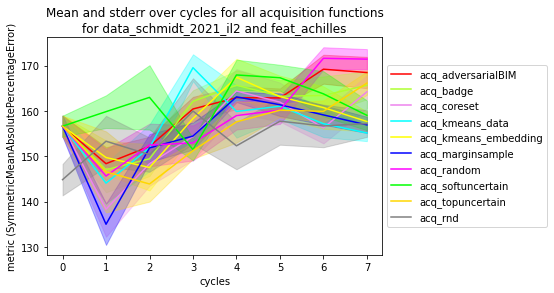

plot 28 out of 60


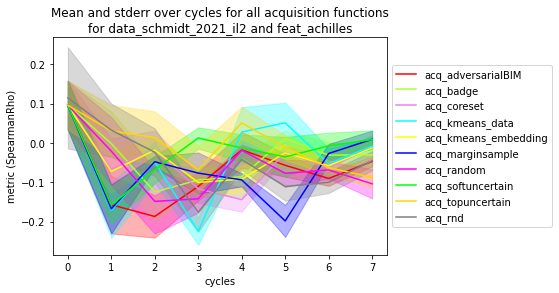

plot 29 out of 60


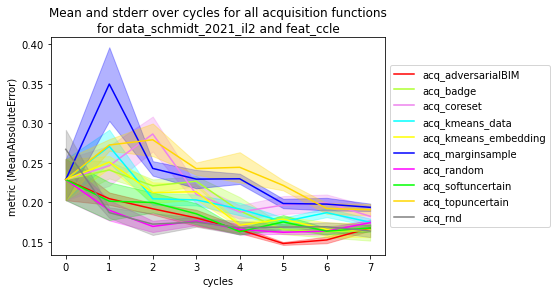

plot 30 out of 60


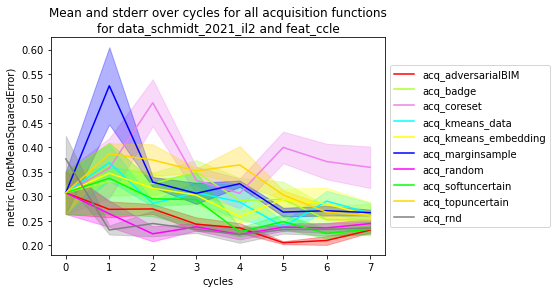

plot 31 out of 60


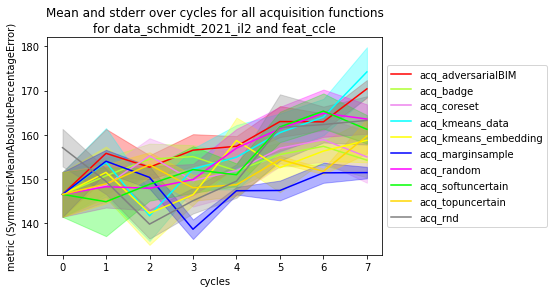

plot 32 out of 60


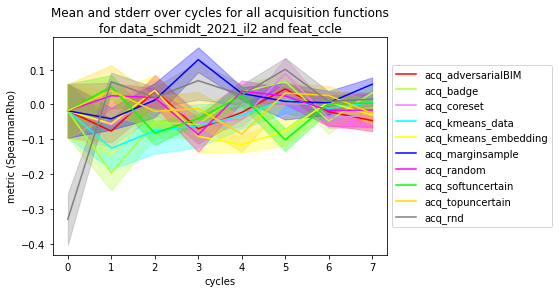

plot 33 out of 60


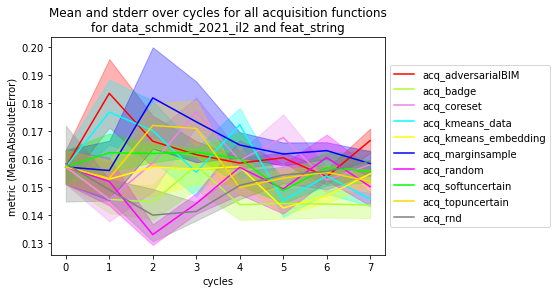

plot 34 out of 60


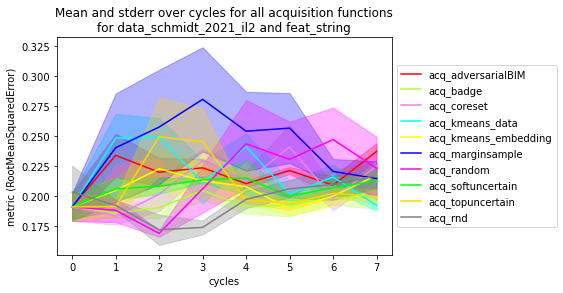

plot 35 out of 60


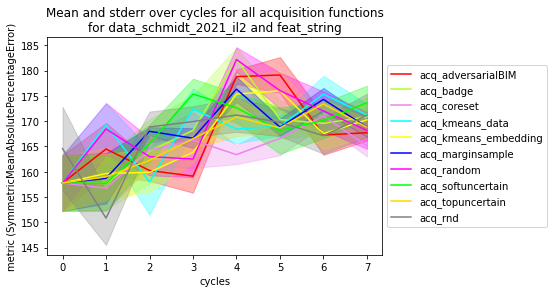

plot 36 out of 60


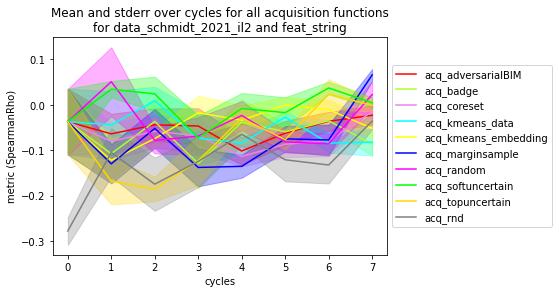

plot 37 out of 60


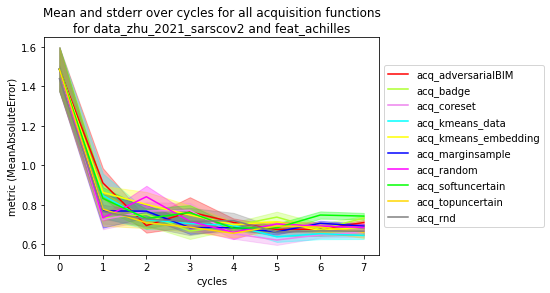

plot 38 out of 60


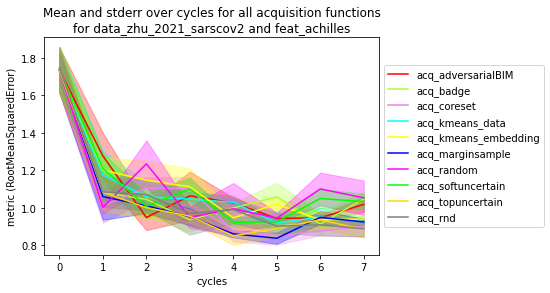

plot 39 out of 60


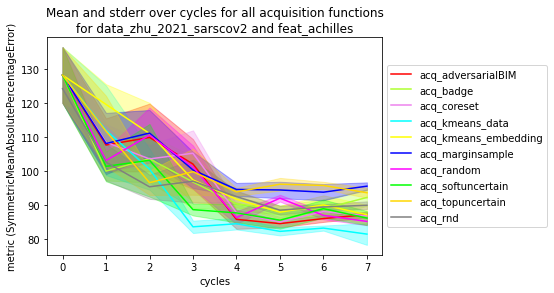

plot 40 out of 60


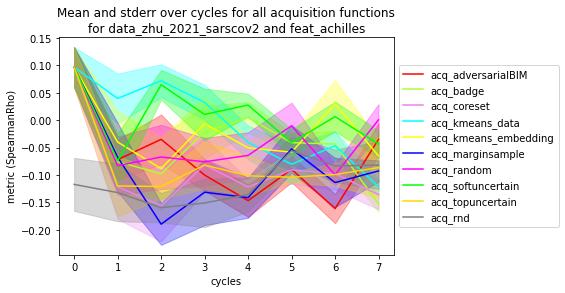

plot 41 out of 60


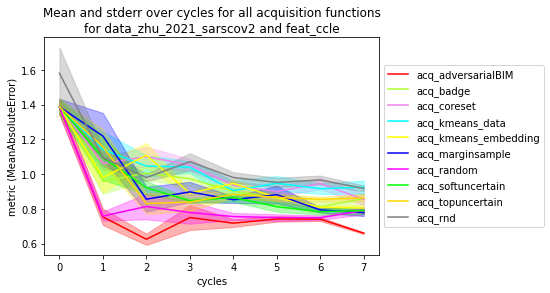

plot 42 out of 60


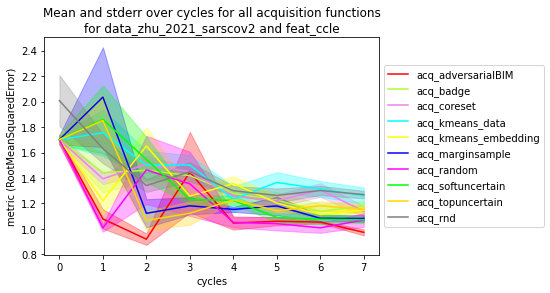

plot 43 out of 60


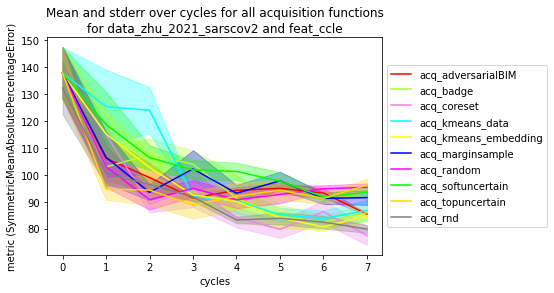

plot 44 out of 60


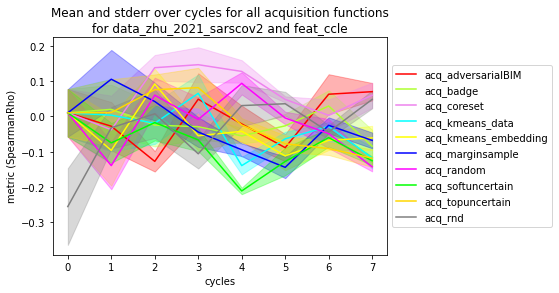

plot 45 out of 60


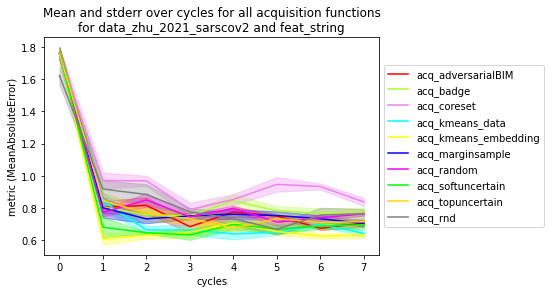

plot 46 out of 60


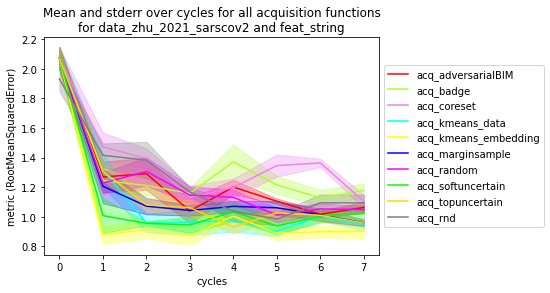

plot 47 out of 60


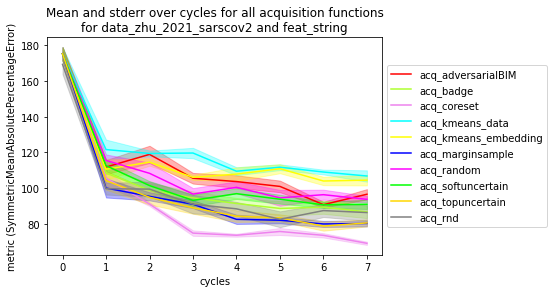

plot 48 out of 60


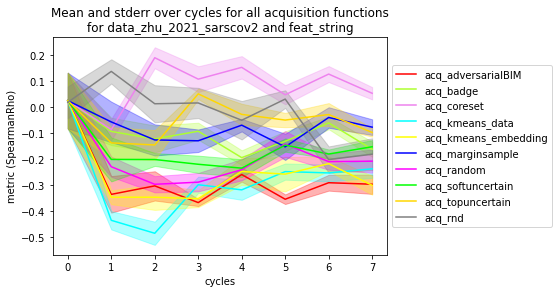

plot 49 out of 60


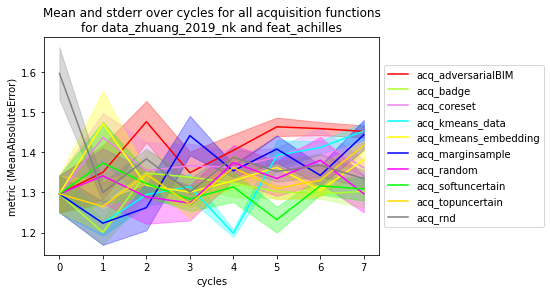

plot 50 out of 60


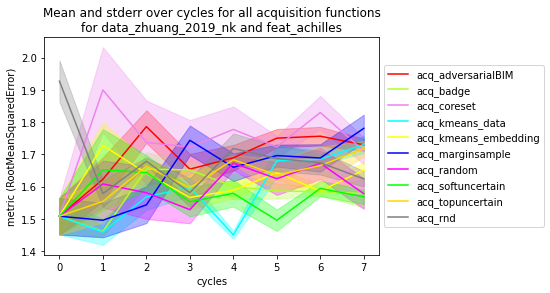

plot 51 out of 60


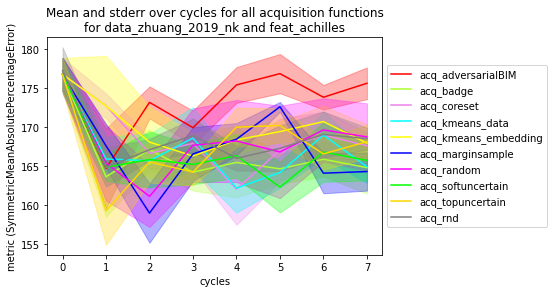

plot 52 out of 60


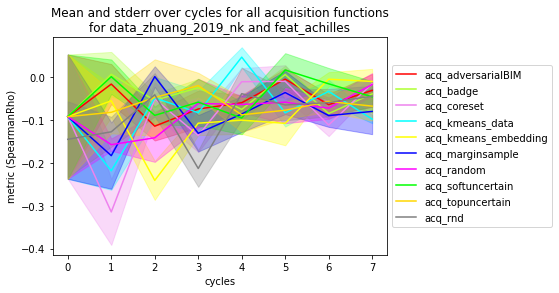

plot 53 out of 60


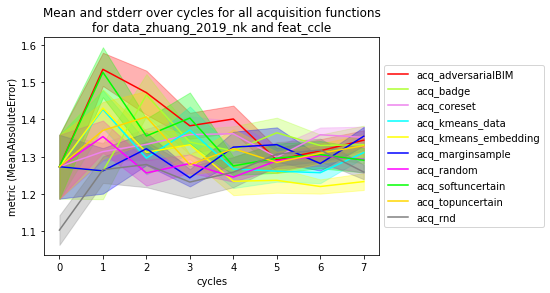

plot 54 out of 60


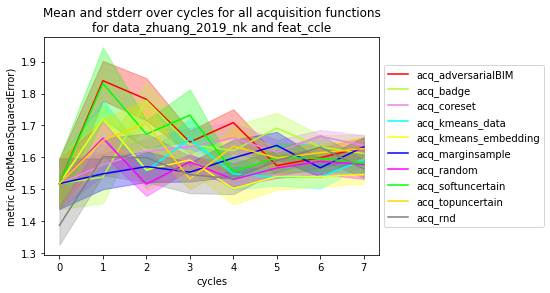

plot 55 out of 60


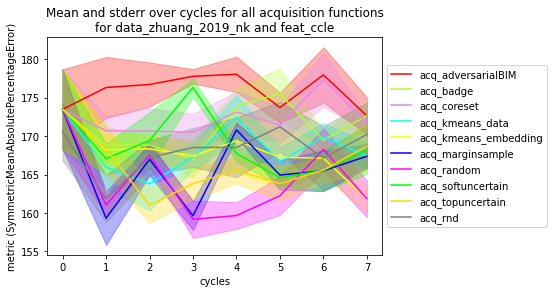

plot 56 out of 60


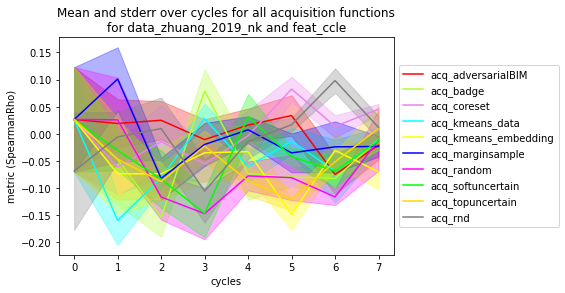

plot 57 out of 60


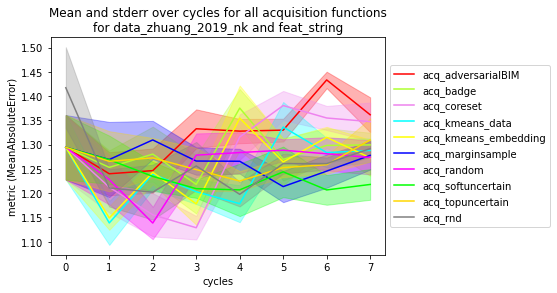

plot 58 out of 60


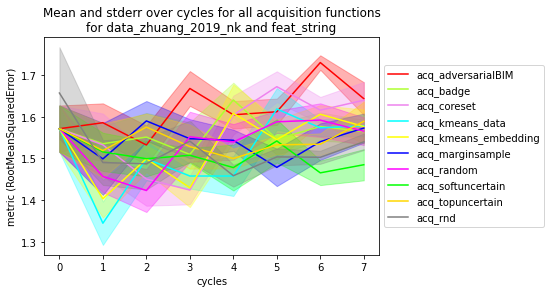

plot 59 out of 60


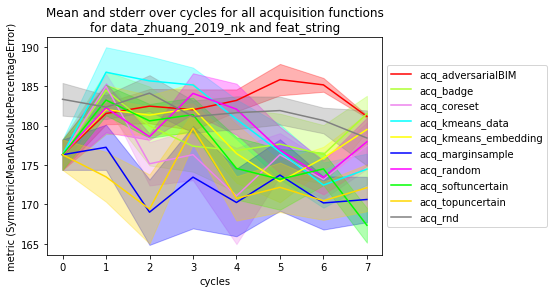

plot 60 out of 60


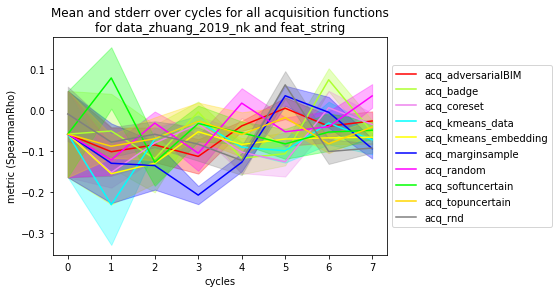

<Figure size 432x288 with 0 Axes>

In [26]:
i=0

datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
feats = ['feat_achilles','feat_ccle','feat_string']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']
folders = ['output','output_rnd','output_umap']
colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','grey','steelblue']

for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run(folders,dataset,feature,metric)
                

plot 1 out of 60


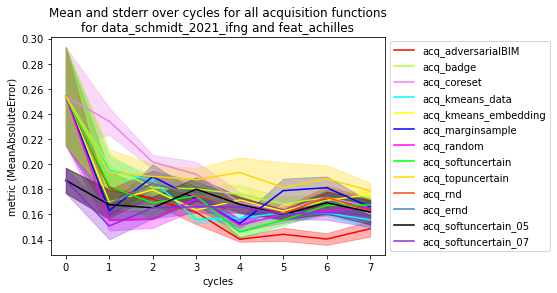

plot 2 out of 60


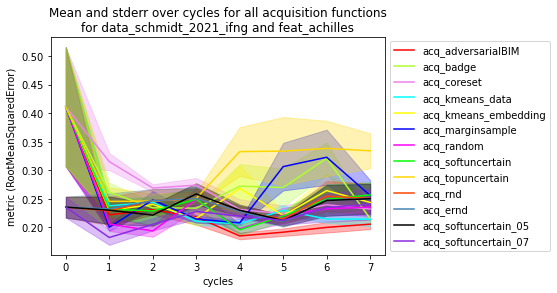

plot 3 out of 60


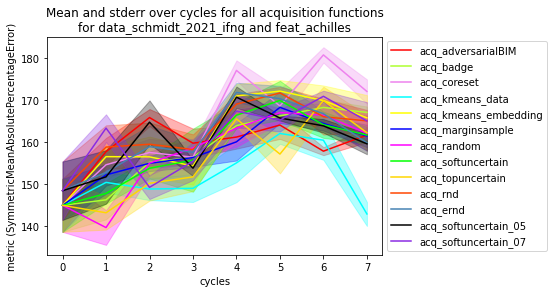

plot 4 out of 60


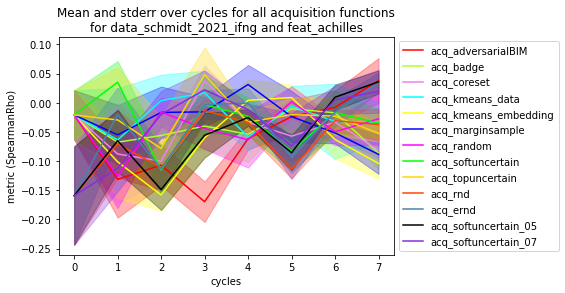

plot 5 out of 60


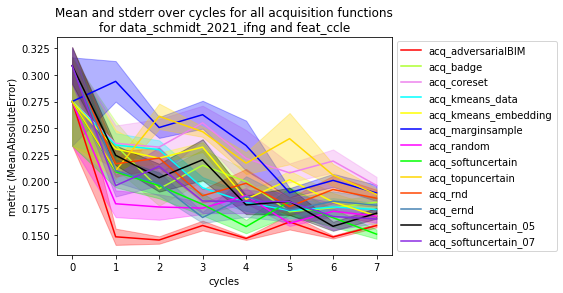

plot 6 out of 60


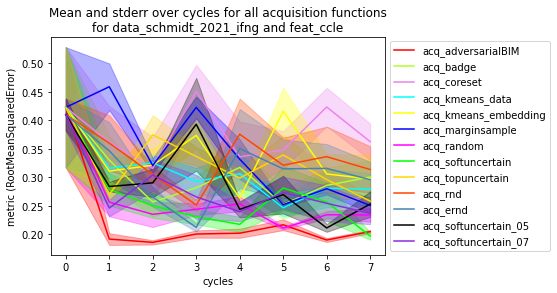

plot 7 out of 60


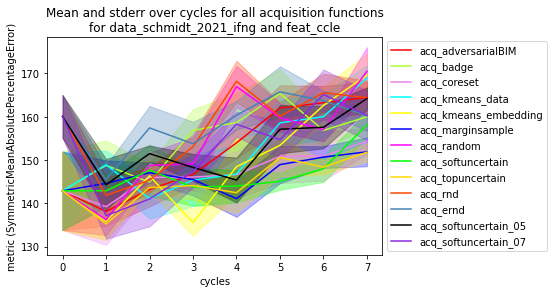

plot 8 out of 60


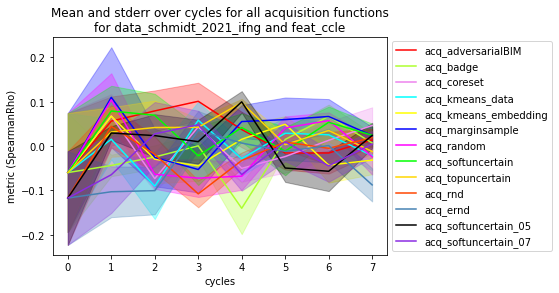

plot 9 out of 60


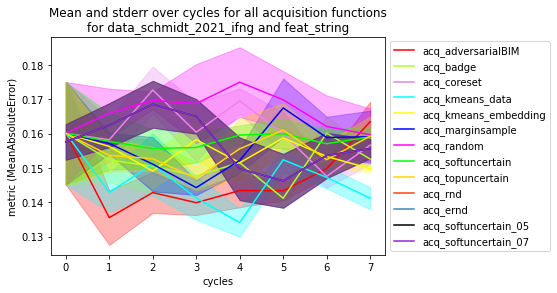

plot 10 out of 60


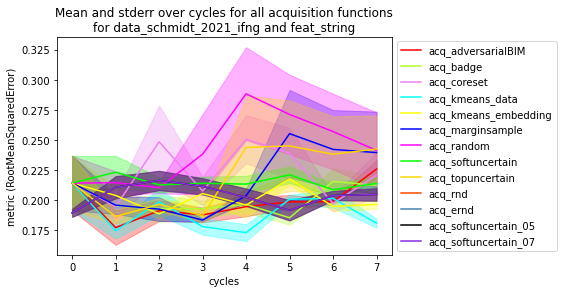

plot 11 out of 60


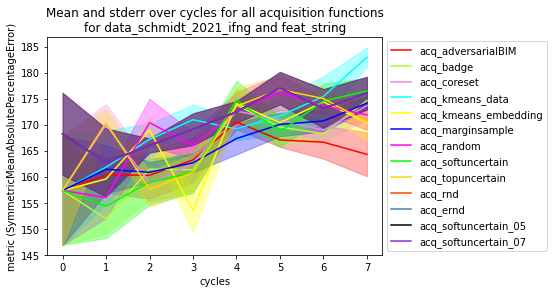

plot 12 out of 60


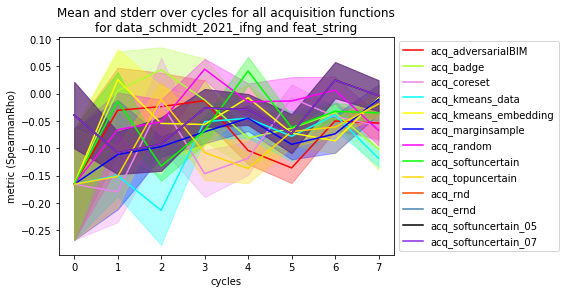

plot 13 out of 60


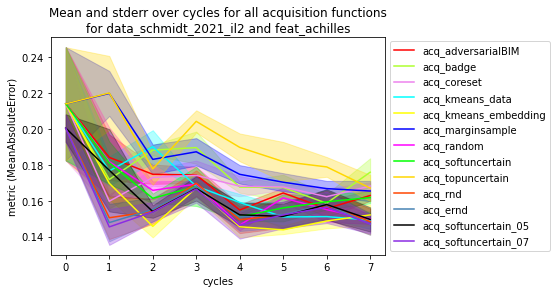

plot 14 out of 60


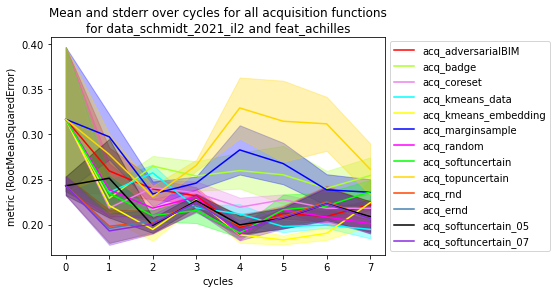

plot 15 out of 60


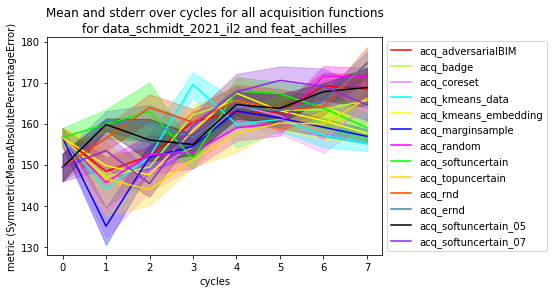

plot 16 out of 60


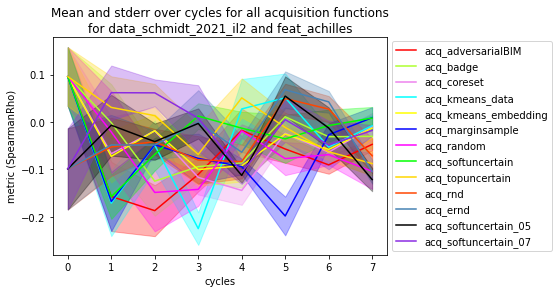

plot 17 out of 60


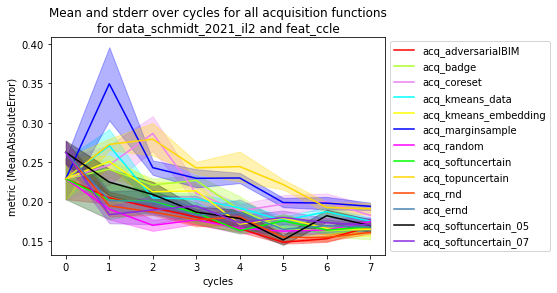

plot 18 out of 60


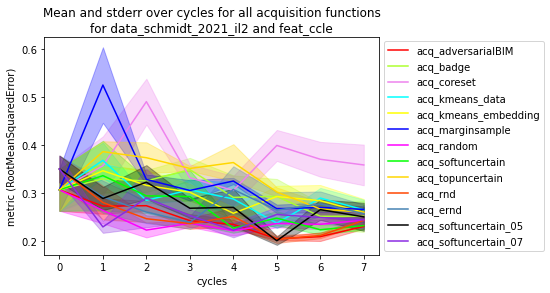

plot 19 out of 60


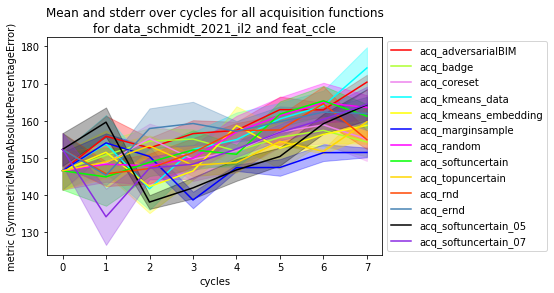

plot 20 out of 60


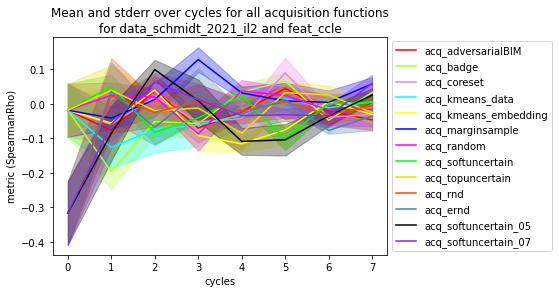

plot 21 out of 60


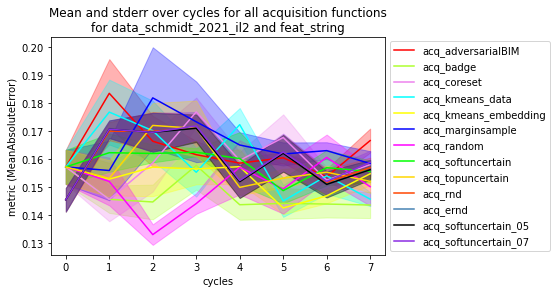

plot 22 out of 60


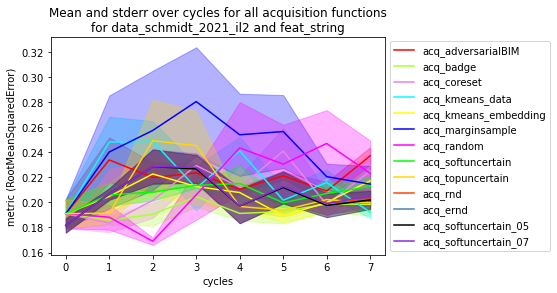

plot 23 out of 60


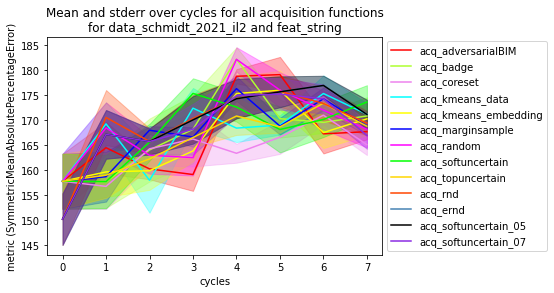

plot 24 out of 60


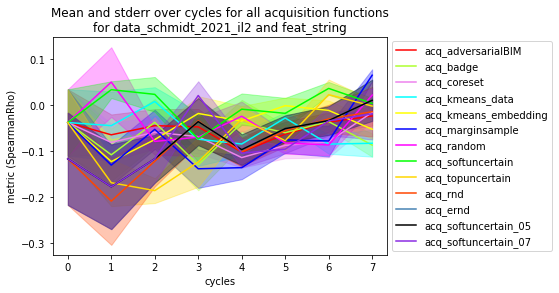

<Figure size 432x288 with 0 Axes>

In [33]:
i=0

#datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
datasets = ['data_schmidt_2021_ifng','data_schmidt_2021_il2']
feats = ['feat_achilles','feat_ccle','feat_string']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']

folders = ['output','output_rnd','output_umap', 'output_4']
#folders=['output_4']

colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','black','blueviolet']

for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run(folders,dataset,feature,metric)
                

plot 1 out of 60


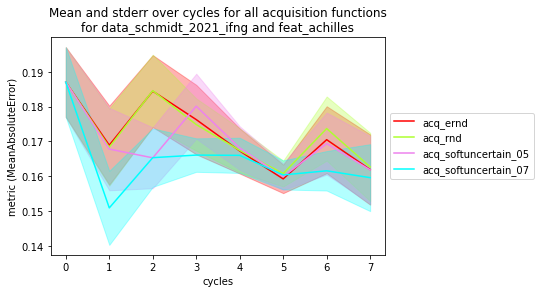

plot 2 out of 60


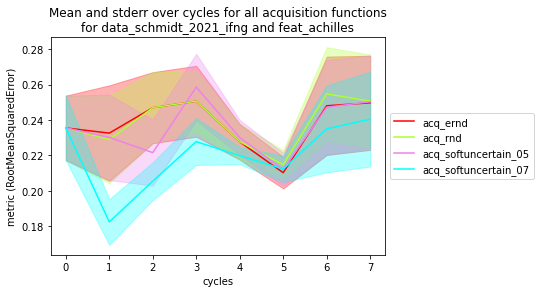

plot 3 out of 60


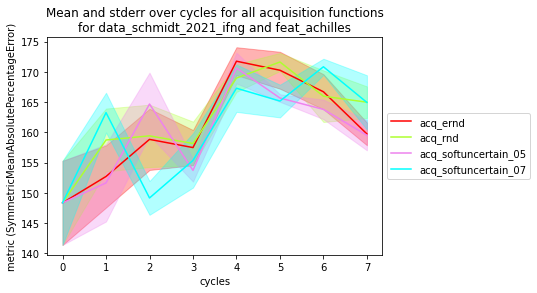

plot 4 out of 60


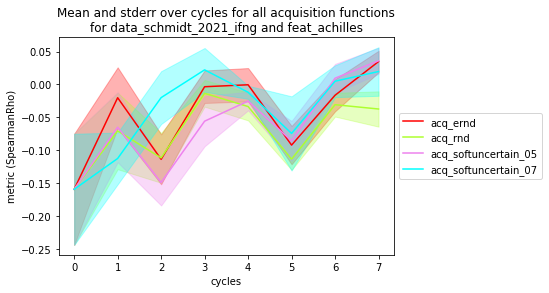

plot 5 out of 60


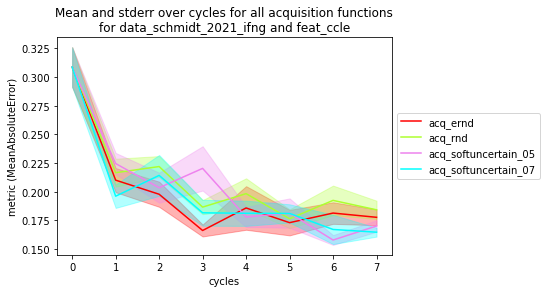

plot 6 out of 60


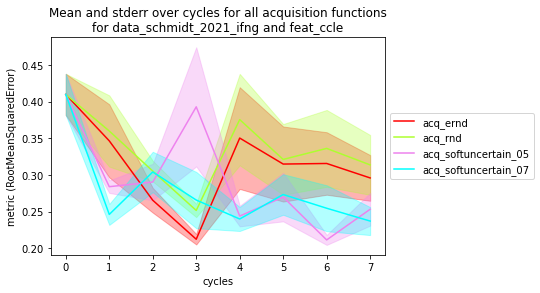

plot 7 out of 60


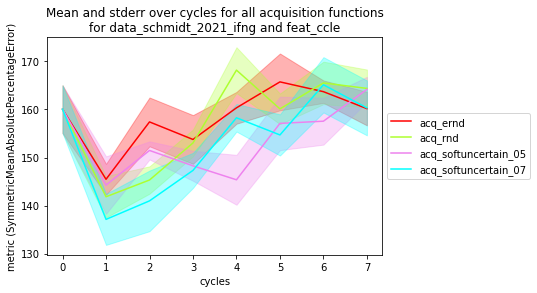

plot 8 out of 60


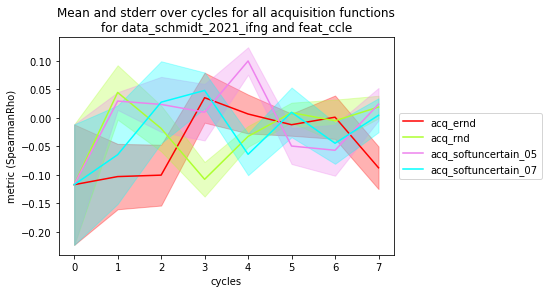

plot 9 out of 60


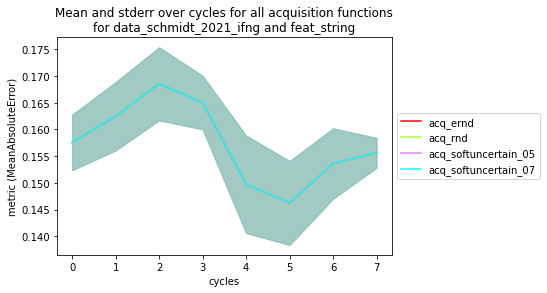

plot 10 out of 60


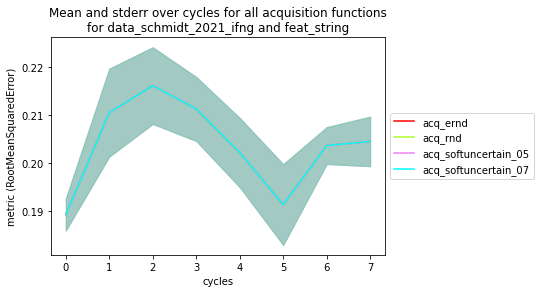

plot 11 out of 60


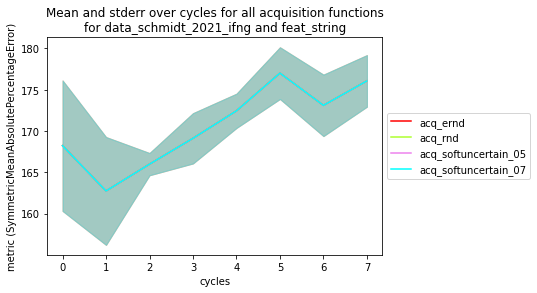

plot 12 out of 60


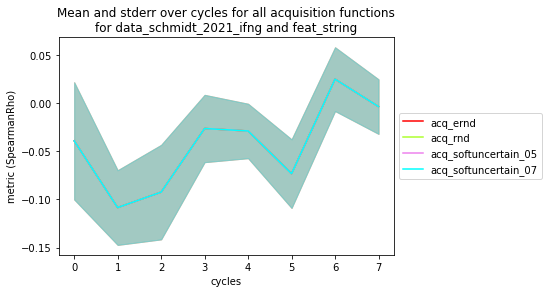

plot 13 out of 60


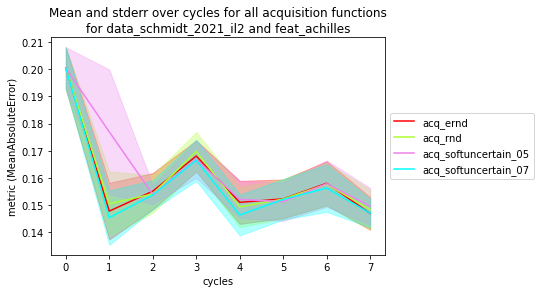

plot 14 out of 60


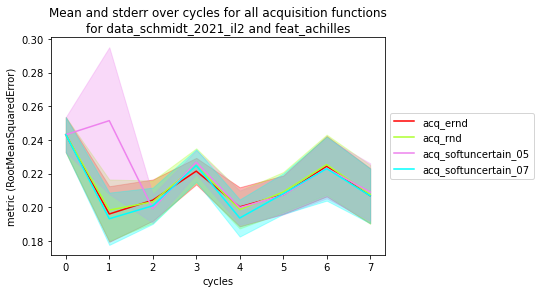

plot 15 out of 60


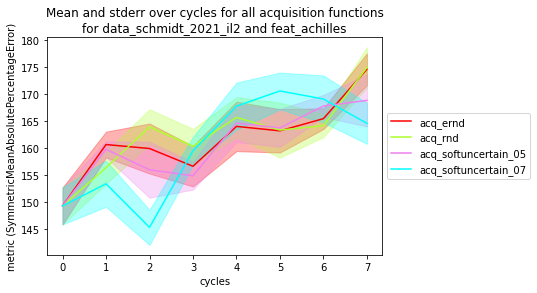

plot 16 out of 60


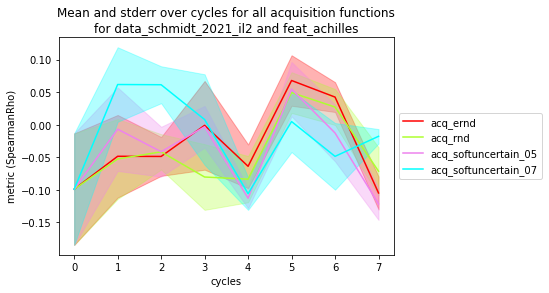

plot 17 out of 60


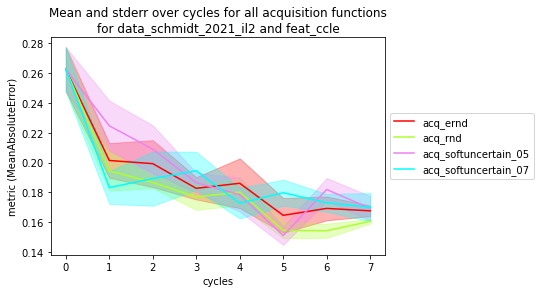

plot 18 out of 60


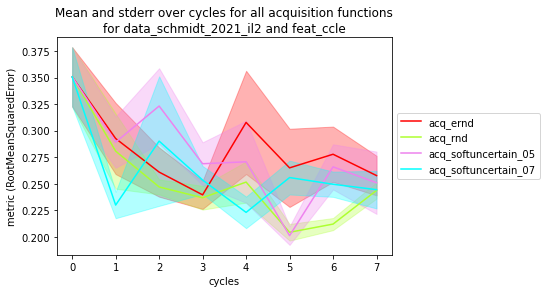

plot 19 out of 60


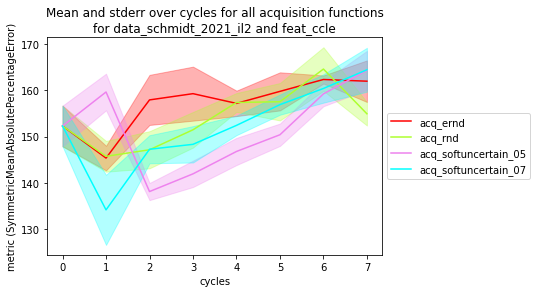

plot 20 out of 60


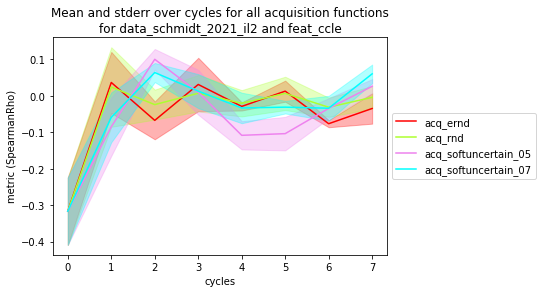

plot 21 out of 60


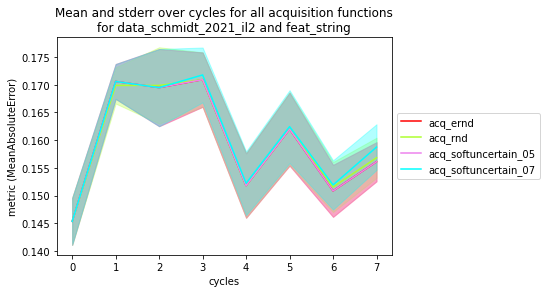

plot 22 out of 60


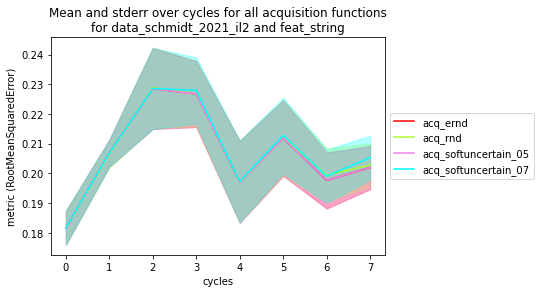

plot 23 out of 60


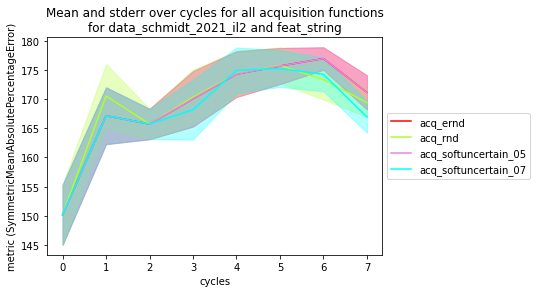

plot 24 out of 60


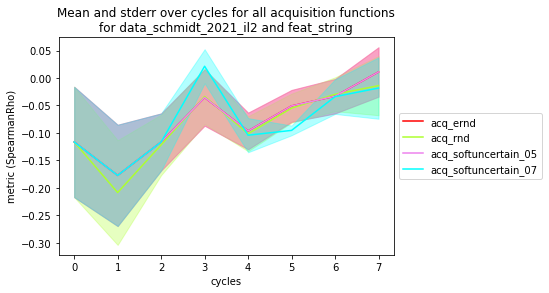

<Figure size 432x288 with 0 Axes>

In [34]:
i=0

#datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
datasets = ['data_schmidt_2021_ifng','data_schmidt_2021_il2']
feats = ['feat_achilles','feat_ccle','feat_string']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']

#folders = ['output','output_rnd','output_umap', 'output_4']
folders=['output_4']

colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','black','blueviolet']

for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run(folders,dataset,feature,metric)
                

plot 1 out of 60
olive


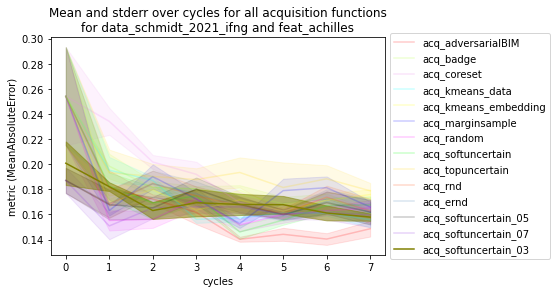

plot 2 out of 60


KeyboardInterrupt: 

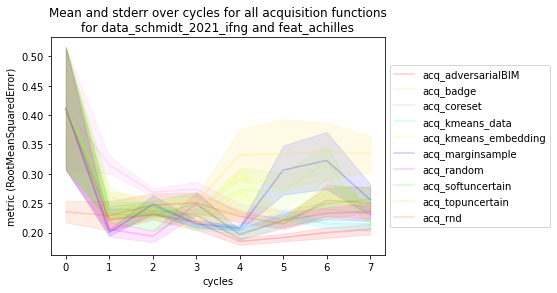

In [24]:
i=0

#datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
datasets = ['data_schmidt_2021_ifng','data_schmidt_2021_il2']
feats = ['feat_achilles','feat_ccle','feat_string']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']

folders = ['output','output_rnd','output_umap', 'output_4','output_softuncertain_03']
#folders=['output_4']

colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','black','blueviolet','olive']
#chosen_acq_function = 'acq_ernd'
chosen_acq_function = 'acq_softuncertain_03'

for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run_against(folders,dataset,feature,metric,chosen_acq_function)
                

plot 1 out of 60
red


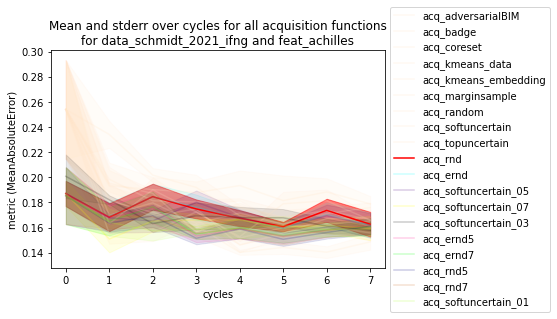

plot 2 out of 60
red


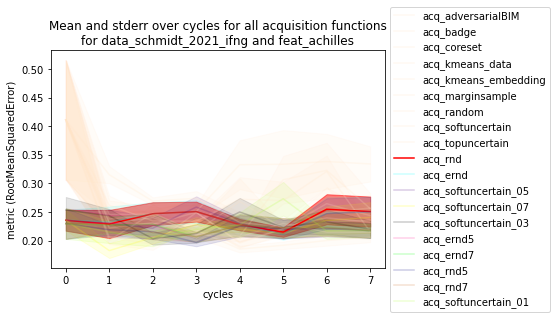

plot 3 out of 60
red


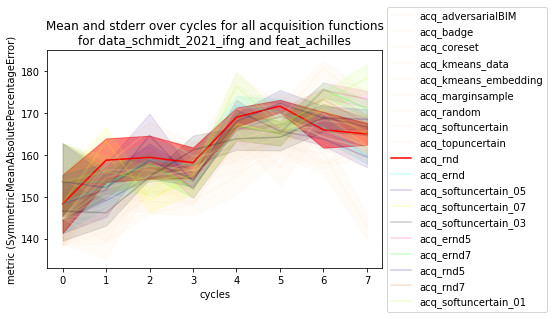

plot 4 out of 60
red


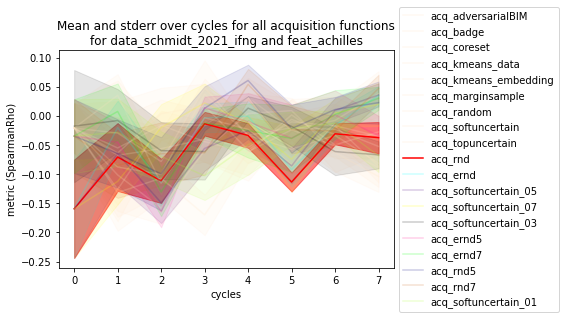

plot 5 out of 60
cyan


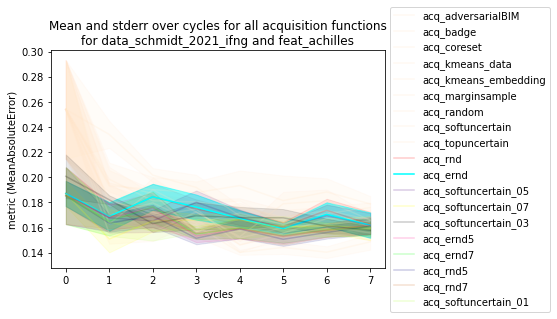

plot 6 out of 60
cyan


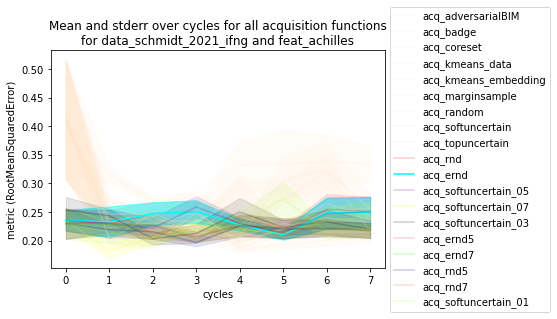

plot 7 out of 60
cyan


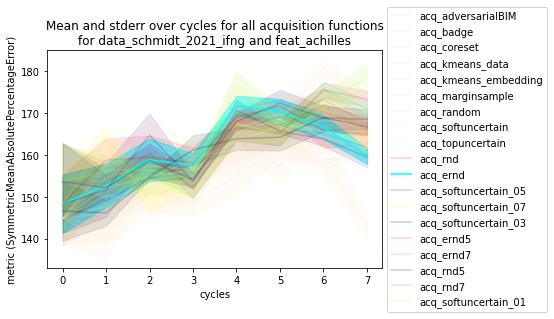

plot 8 out of 60
cyan


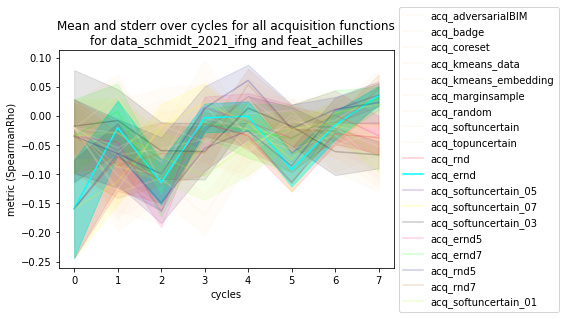

plot 9 out of 60
indigo


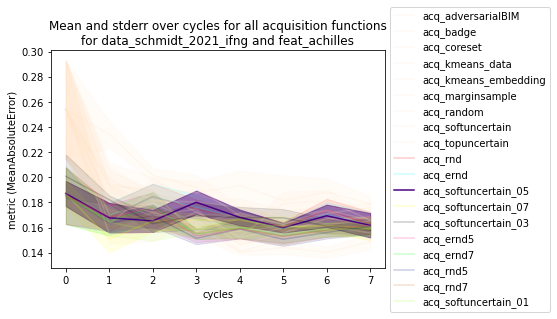

plot 10 out of 60
indigo


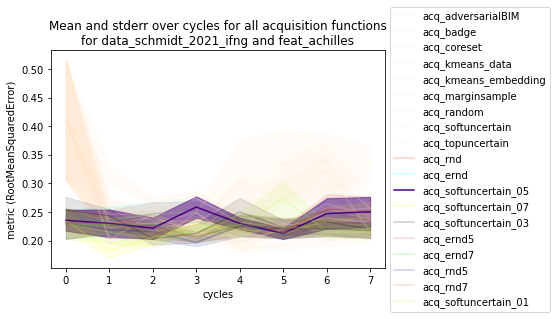

plot 11 out of 60
indigo


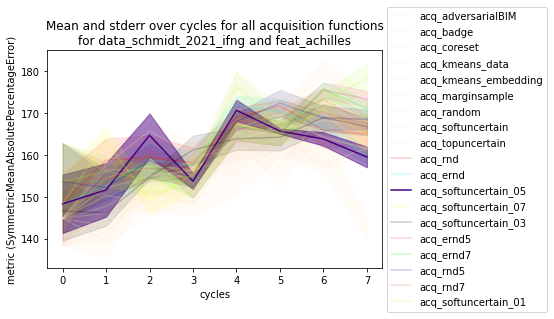

plot 12 out of 60
indigo


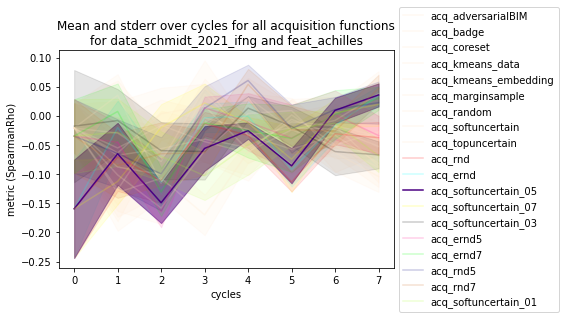

plot 13 out of 60
yellow


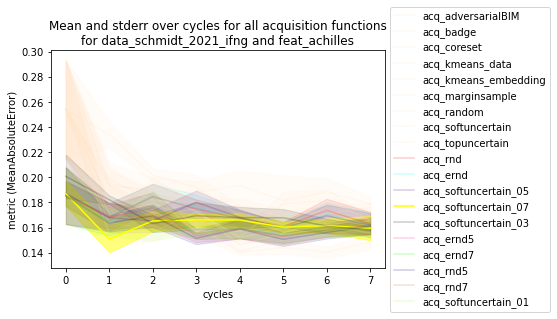

plot 14 out of 60
yellow


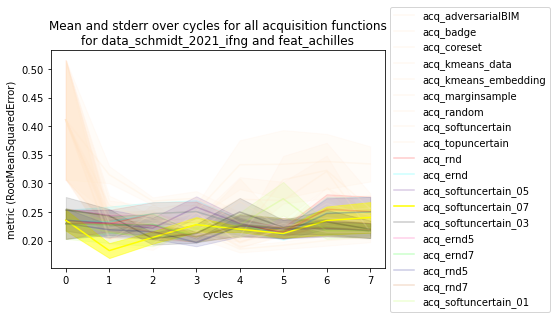

plot 15 out of 60
yellow


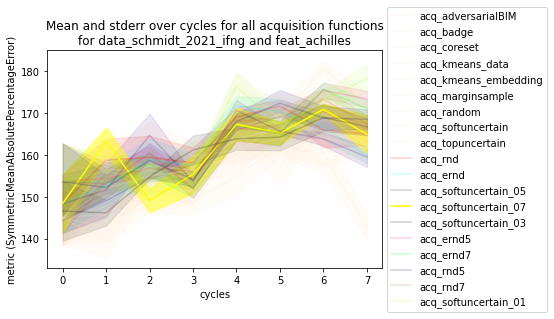

plot 16 out of 60
yellow


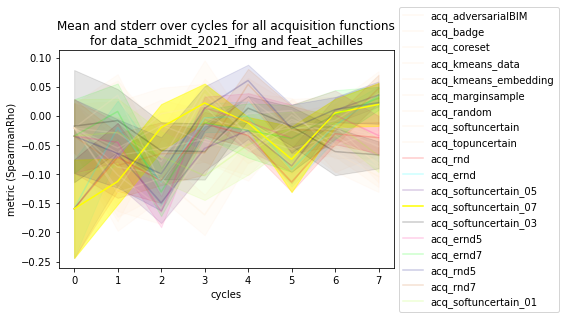

plot 17 out of 60
black


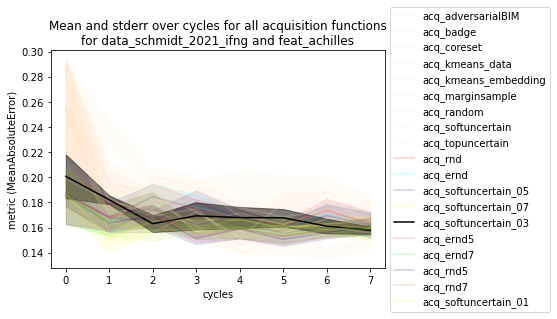

plot 18 out of 60
black


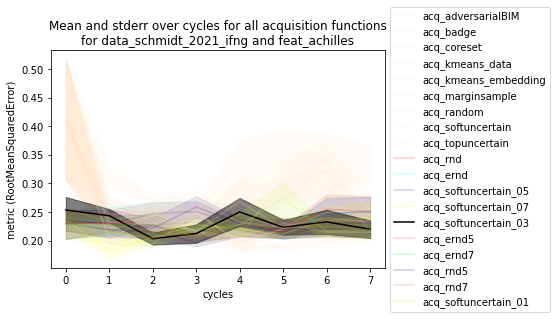

plot 19 out of 60
black


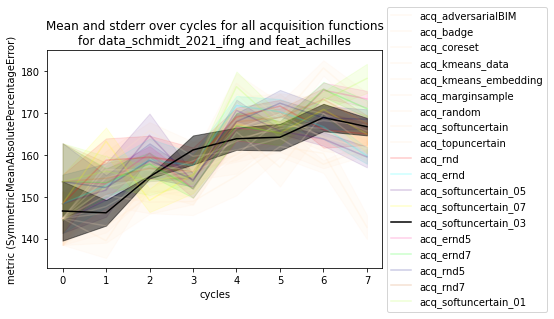

plot 20 out of 60
black


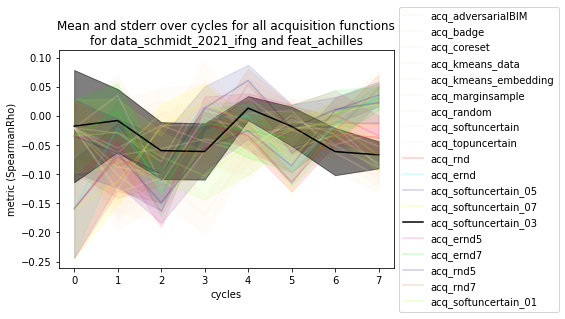

plot 21 out of 60
deeppink


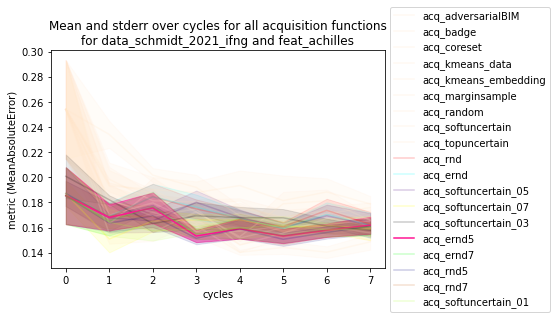

plot 22 out of 60
deeppink


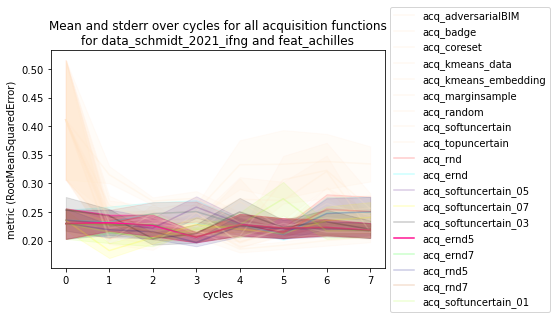

plot 23 out of 60
deeppink


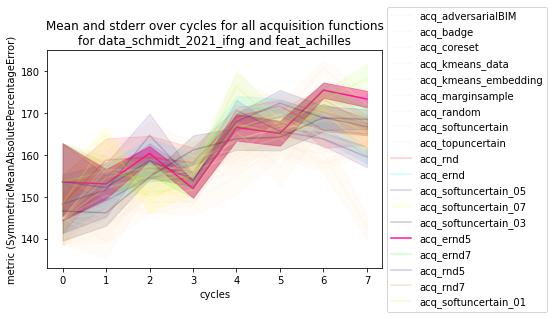

plot 24 out of 60
deeppink


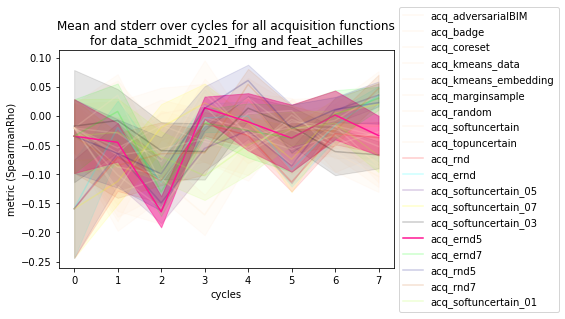

plot 25 out of 60
lime


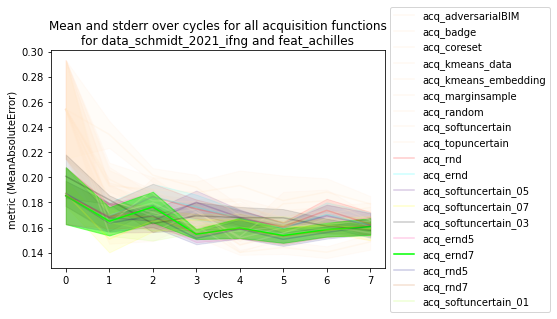

plot 26 out of 60
lime


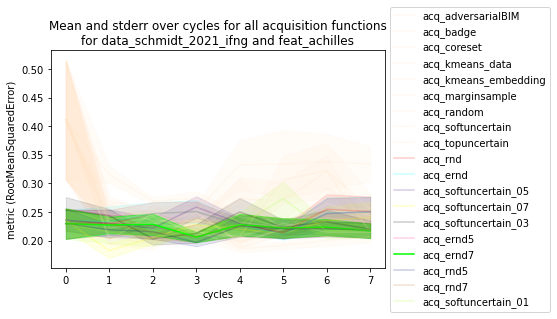

plot 27 out of 60
lime


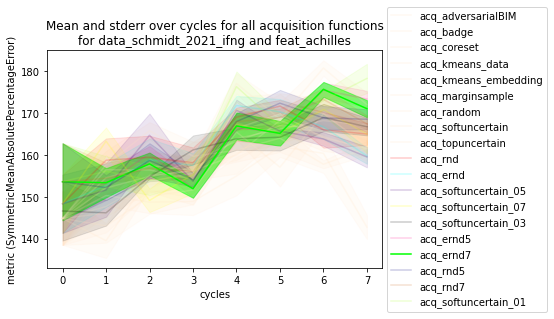

plot 28 out of 60
lime


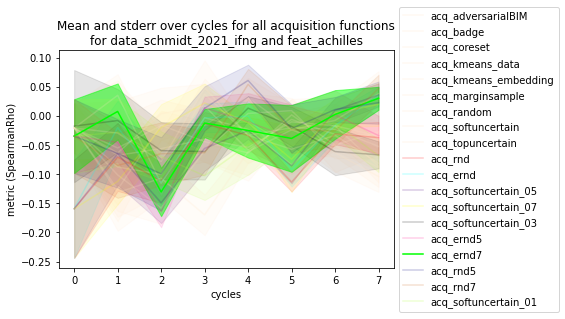

plot 29 out of 60
navy


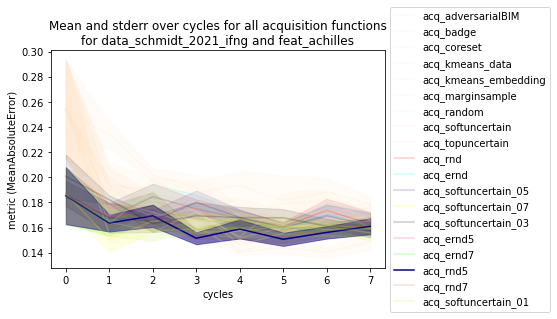

plot 30 out of 60
navy


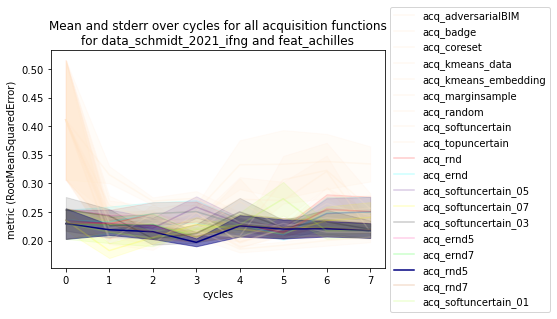

plot 31 out of 60
navy


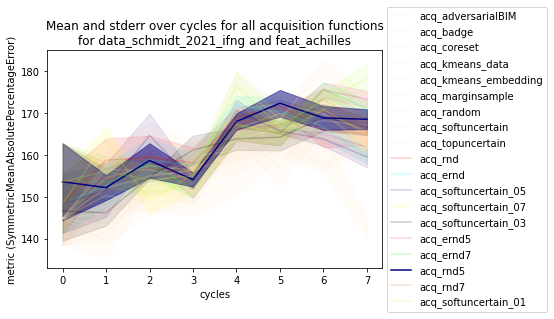

plot 32 out of 60
navy


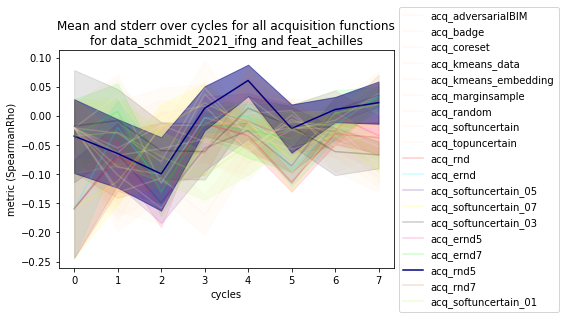

plot 33 out of 60
chocolate


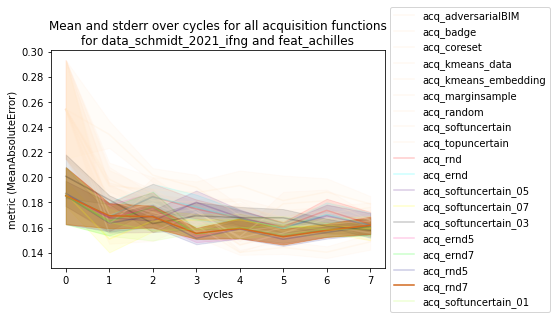

plot 34 out of 60
chocolate


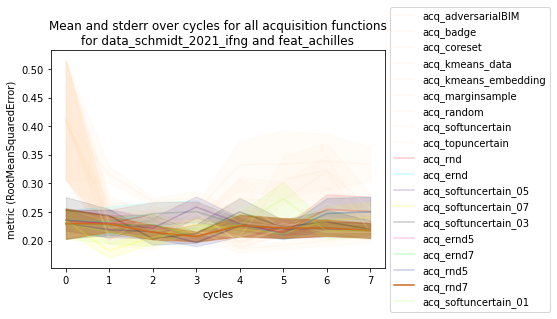

plot 35 out of 60
chocolate


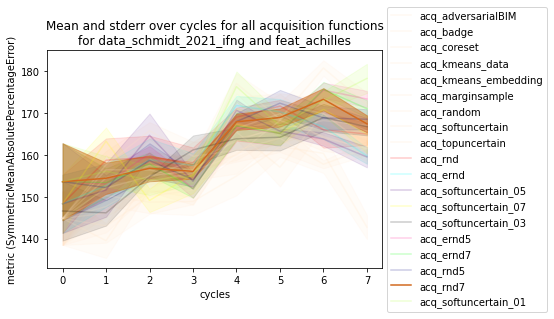

plot 36 out of 60
chocolate


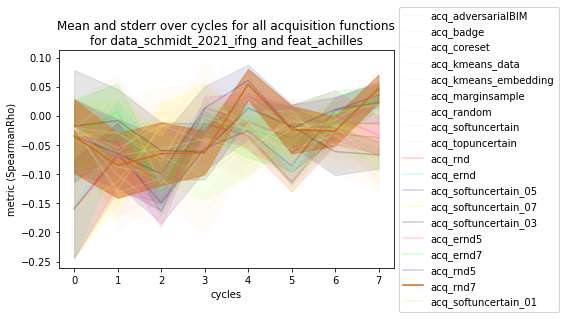

plot 37 out of 60
greenyellow


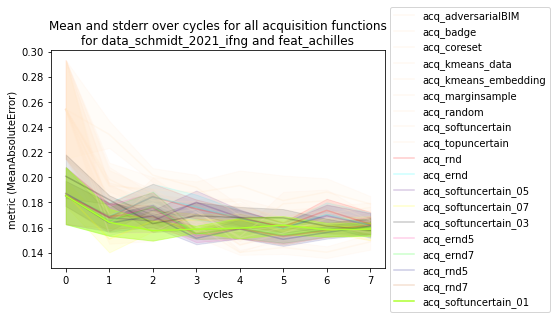

plot 38 out of 60
greenyellow


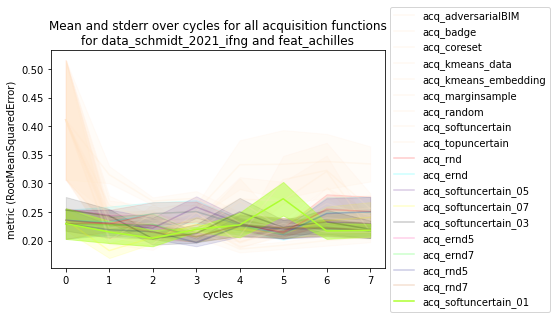

plot 39 out of 60
greenyellow


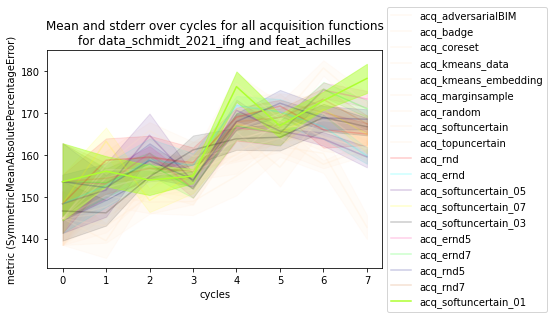

plot 40 out of 60
greenyellow


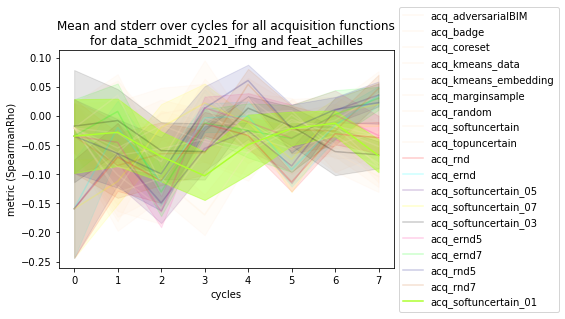

<Figure size 432x288 with 0 Axes>

In [27]:
i=0

#datasets = ['data_sanchez_2021_tau','data_schmidt_2021_ifng','data_schmidt_2021_il2','data_zhu_2021_sarscov2','data_zhuang_2019_nk']
datasets = ['data_schmidt_2021_ifng']
feats = ['feat_achilles']
metrics = ['MeanAbsoluteError','RootMeanSquaredError','SymmetricMeanAbsolutePercentageError','SpearmanRho']
#colors=['red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold']

folders = ['output','output_rnd','output_umap', 'output_4','output_softuncertain_03','output_different_temp']
#folders=['output_4']

colors=[#'bisque','lightcoral','lightcoral','lightcoral','lightcoral','lightcoral','lightcoral','lightcoral','lightcoral',
        'bisque','bisque','bisque','bisque','bisque','bisque','bisque','bisque','bisque',
        'red','cyan','indigo','yellow','black','deeppink','lime','navy','chocolate','greenyellow','darkolivegreen'
   # 'red','greenyellow','violet','cyan','yellow','blue','magenta','lime','gold','orangered','steelblue','black',
    #        'blueviolet','olive',
     #       'darkblue', 'lightcoral','tan','mediumspringgreen','black','black'
        ]
#chosen_acq_function = 'acq_ernd'
chosen_acq_function = 'acq_softuncertain_03'
chosen_acqs = ['acq_rnd','acq_ernd','acq_softuncertain_05','acq_softuncertain_07','acq_softuncertain_03','acq_ernd5','acq_ernd7','acq_rnd5','acq_rnd7','acq_softuncertain_01']
for chosen_one in chosen_acqs:
    for dataset in datasets:
        for feature in feats:
            for metric in metrics:
                i+=1
                print(f'plot {i} out of 60')
                run_against(folders,dataset,feature,metric,chosen_one)
                